### Importing the necessary libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
%matplotlib inline

import datetime as dt
from datetime import timedelta

from sklearn import datasets, linear_model
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
lc = LabelEncoder()

import statsmodels
import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.model_selection import train_test_split, cross_val_score, RepeatedKFold, GridSearchCV
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error,mean_absolute_percentage_error
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression

from sklearn.pipeline import make_pipeline, Pipeline

from numpy import arange
from sklearn.linear_model import Lasso,LassoCV, Ridge
from sklearn.linear_model import LogisticRegression
from sklearn.kernel_ridge import KernelRidge


from sklearn import tree
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, export_graphviz
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, BaggingRegressor, RandomForestRegressor
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import plot_confusion_matrix, accuracy_score
from sklearn.metrics import roc_curve, auc, plot_roc_curve

# Trick to widen the screen
from IPython.core.display import display, HTML

#Widens the code landscape 
display(HTML("<style>.container { width:95% !important; }</style>"))

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns',500)
pd.set_option('display.max_rows', 50)
# sns.set_style('whitegrid')

C:\Users\usman\AppData\Local\Temp\ipykernel_3528\16203166.py:41: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


## Loading the datasets

First we will mount drive and then we will load our data sets

In [126]:
# from google.colab import drive
# drive.mount("/content/drive")

### Loading the TheGeneral dataset

In [3]:
df_TheGeneral = pd.read_csv('Dataset/TheGeneral.csv', header = 0)

In [4]:
df_TheGeneral.head()

,AbilitecContactID,PolicyNumber,DriverNumber,AbilitecHouseholdID,DriverCount,ClaimCount,TotalPaid,ClaimNumber,AtFaultDescription,ClaimStatus,ClaimType,DateOfLoss,DriverID,LossState,PolicyStateCode,SubrogrationFlag,TermEffectiveDate,VehicleID,ClaimTransCount,ClaimTransPaidLoss,DaysToClaim,DaysToClaim_h
0,04ZJUS02EXPR09CB,Q080MDE1MTY2,1,04ZJUS0300X496LW,4,1,5086.61,PA0002364104,No fault,C,HAIL,2018-08-06 00:00:00,98,CO,CO,NO,2018-05-29 00:00:00,1,9.0,5086.61,0.0,0.0
1,04ZJUS0146KL4TTS,Q080MDEwOTEx,1,04ZJUS035SBF0GJ4,2,1,0.00,PA0002351705,Insured at fault,C,PG_IVREARENDCV,2018-05-24 00:00:00,1,CO,CO,NO,2018-05-24 00:00:00,1,4.0,0.00,0.0,0.0
2,04ZJUS02K2KC7DMW,Q080MDExOTIz,1,04ZJUS035ZXBZEH1,2,1,21397.74,PA0002344011,Insured at fault,C,PG_COLLISIONINTERSECTION,2018-06-17 00:00:00,1,CO,CO,NO,2018-05-25 00:00:00,1,53.0,21397.74,0.0,0.0
3,04ZJUS022XH2NVJ5,Q080MDIyMDcw,1,04ZJUS038P3W5KKR,5,3,0.00,PA0002348918,No fault,C,HAIL,2018-06-19 00:00:00,98,CO,CO,YES,2018-06-01 00:00:00,2,14.0,0.00,0.0,0.0
4,04ZJUS022XH2NVJ5,Q080MDIyMDcw,1,04ZJUS038P3W5KKR,5,3,0.00,PA0002348997,No fault,C,GLASSBREAKAGE,2018-06-30 00:00:00,1,CO,CO,NO,2018-06-01 00:00:00,2,1.0,0.00,0.0,0.0


### Loading the MasterQuote dataset

In [6]:
df_MasterQuote = pd.read_csv('Dataset/MasterQuote.csv', header = 0)

In [7]:
df_MasterQuote.head()

,QuoteNumber,MQuotedTotalPayment,BiFcCoverageInd,CoverageTypeDescription,DriversActive,GaragingState,NamedInsuredMaritalStatus,PolicyNumber,PolicyStateCode,PolicyTerm,QuoteInitiatedTime,TermEffectiveDate,TermExpirationDate,AbilitecContactID,DriverNumber,AbilitecHouseholdID,DriverCount
0,MzM0MDA0OTE=,1136.0,BI NOFC,Liability Only,1,OR,Single,T1IyNzE0OTQ0,OR,12,2016-01-02 22:25:47,2016-01-02 00:00:00,2017-01-02 00:00:00,04ZJUS0220X4MKG7,1,04ZJUS033FV1YJP0,1
1,MzM0MDQxNzU=,0.0,NOBI NOFC,Liability Only,1,IL,Divorced,NaN,IL,12,2016-01-03 12:15:55,2016-01-03 00:00:00,2017-01-03 00:00:00,04ZJUS02W4N0B2J5,1,04ZJUS03543132P3,1
2,MzM0MTc2MTk=,1160.0,BI NOFC,Liability Only,2,NV,Married,TlYyNzE2MTE5,NV,12,2016-01-04 11:10:58,2016-01-04 00:00:00,2017-01-04 00:00:00,04ZJUS01KNTMYEQF,1,04ZJUS03X6MXZ21T,2
3,MzM0MTk3MjQ=,3054.0,BI FC,Full Coverage,2,RI,Married,UkkyNzQ3ODg1,RI,12,2016-01-04 12:09:06,2016-01-26 00:00:00,2017-01-26 00:00:00,04ZJUS02XQ1DGSDW,2,04ZJUS03ZDK4PGRF,1
4,MzM0MjAxMjU=,0.0,NOBI NOFC,Liability Only,1,OH,Single,NaN,OH,12,2016-01-04 12:20:07,2016-01-04 00:00:00,2017-01-04 00:00:00,04ZJUS023RYMYKKP,1,04ZJUS036201CX3G,1


### loading the Abilitech dataset 
* You can choose the most useful predictors from the Abilitech dataset in addition to the above data for your models

In [8]:
df_Abilitech = pd.read_csv('Dataset/df_AP02.csv', header = 0)
df_Abilitech.head()


,AbilitecContactID,ACX_ZIPCODE,ACX_ZIP4,AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913,AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_Of_181_To_225_Fin_rank_base_20_AP004916,AP004921_Never_Or_Rarely_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004921,AP004922_Sometimes_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004922,AP004923_Usually_Or_Always_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004923,AP004924_Have_Accepted_Pre_Approved_Credit_Card_Offer_In_Past_12_Months_Fin_rank_base_20_AP004924,AP004925_Have_Used_Credit_Cards_For_Business_Purposes_Fin_rank_base_20_AP004925,AP004926_Have_Used_Credit_Cards_For_Personal_Purposes_Fin_rank_base_20_AP004926,AP004927_Use_A_Debit_Card_For_Personal_Use_Less_Than_Once_Per_Month_Fin_rank_base_20_AP004927,AP004928_Have_Used_Credit_Cards_For_Personal_Purchases_More_Than_20_Times_Per_Month_Fin_rank_base_20_AP004928,AP004929_Have_Used_Credit_Cards_For_Personal_Purchases_Between_11_20_Times_Per_Month_Fin_rank_base_20_AP004929,AP004930_Have_Used_Credit_Cards_For_Personal_Purchases_Between_6_10_Times_Per_Month_Fin_rank_base_20_AP004930,AP004931_Have_Used_Credit_Cards_For_Personal_Purchases_Between_1_5_Times_Per_Month_Fin_rank_base_20_AP004931,AP004932_Have_Used_Credit_Cards_For_Personal_Purchases_Less_Than_One_Time_Per_Month_Fin_rank_base_20_AP004932,AP004933_Use_A_Debit_Card_For_Personal_Use_More_Than_20_Times_Per_Month_Fin_rank_base_20_AP004933,AP004934_Use_A_Debit_Card_For_Personal_Use_Between_11_20_Times_Per_Month_Fin_rank_base_20_AP004934,AP004935_Use_A_Debit_Card_For_Personal_Use_Between_6_10_Times_Per_Month_Fin_rank_base_20_AP004935,AP004936_Use_A_Debit_Card_For_Personal_Use_Between_1_5_Times_Per_Month_Fin_rank_base_20_AP004936,AP004937_Have_Personal_Or_Joint_Home_Mortgage_1St_Fin_rank_base_20_AP004937,AP004938_Have_Acquired_Personal_Joint_Home_Mortgage_1St_In_Past_12_Months_Fin_rank_base_20_AP004938,AP004939_Have_Personal_Or_Joint_2Nd_Mortgage_Home_Equity_Loan_Fin_rank_base_20_AP004939,AP004940_Have_Personal_Or_Joint_Mortgage_Refinance_Consolidation_Loan_Fin_rank_base_20_AP004940,AP004941_Have_Personal_Or_Joint_Auto_Loan_Fin_rank_base_20_AP004941,AP004942_Have_Acquired_Personal_Joint_Auto_Loan_In_Past_12_Months_Fin_rank_base_20_AP004942,AP004943_Have_Personal_Or_Joint_Education_Student_Loan_Fin_rank_base_20_AP004943,AP004944_Have_Personal_Or_Joint_Loan_Not_For_Education_Purposes_Fin_rank_base_20_AP004944,AP004945_Have_Personal_Or_Joint_Personal_Line_Of_Credit_Fin_rank_base_20_AP004945,AP004946_Have_Personal_Or_Joint_Home_Equity_Line_Of_Credit_Fin_rank_base_20_AP004946,AP004947_Household_Owns_A_Vacation_Weekend_Home_Fin_rank_base_20_AP004947,AP004948_Household_Owns_Real_Estate_For_Investment_Purposes_Fin_rank_base_20_AP004948,AP004949_Household_Owns_Any_Type_Of_Real_Estate_Fin_rank_base_20_AP004949,AP004950_Household_Own_One_Vacation_Weekend_Home_Fin_rank_base_20_AP004950,AP004951_Household_Owns_One_Property_For_Real_Estate_Investment_Fin_rank_base_20_AP004951,AP004952_Household_Used_A_Real_Estate_Agent_To_Sell_A_Property_Fin_rank_base_20_AP004952,AP004953_Household_Used_A_Real_Estate_Agent_To_Buy_A_Property_Fin_rank_base_20_AP004953,AP004954_Household_Used_A_Real_Estate_Agent_Fin_rank_base_20_AP004954,AP004955_Household_Used_Other_Type_Of_Real_Estate_Agent_Fin_rank_base_20_AP004955,AP004958_Personal_Or_Joint_Savings_Account_Fin_rank_base_20_AP004958,AP004959_Acquired_A_Saving_Account_In_Past_12_Months_Fin_rank_base_20_AP004959,AP004960_Personal_Or_Joint_Cd_Certificate_Of_Deposit_Account_Fin_rank_base_20_AP004960,AP004961_Personal_Or_Joint_Interest_Checking_Account_Fin_rank_base_20_AP004961,AP004962_Acquired_An_Interest_Checking_Account_In_Past_12_Months_Fin_rank_base_20_AP004962,AP004963_Personal_Or_Joint_Non_Interest_Checking_Account_Fin_rank_base_20_AP004963,AP004964_Acquired_A_Non_Interest_Checking_Account_In_Past_12_Months_Fin_rank_base_20_AP004964,AP004965_Personal_Or_Joint_Moneymarket_Account_Fin_r

In [9]:
df_Abilitech.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96501 entries, 0 to 96500
Data columns (total 300 columns):
 #    Column                                                                                                                      Dtype  
---   ------                                                                                                                      -----  
 0    AbilitecContactID                                                                                                           object 
 1    ACX_ZIPCODE                                                                                                                 int64  
 2    ACX_ZIP4                                                                                                                    float64
 3    AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913                       float64
 4    AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_

# 4.  Exploratory Analysis

* You are expected to conduct some initial exploratory analysis and some visualizations. Make sure to explain the insight you got from that analysis

* Once you completed the modeling and obtain the result, You are expected to conduct exploratory analysis and some visualizations that can give some insight of your model and the results



In below section of code, we will do some exploratory analysis along with 
some visualisations, to get better insight of data. We will do analysis on 
TheGenerals, MasterQuote & Abilitech datasets.

In [10]:
# let's first get shape of each data set
print(f"TheGenerals Dataset Shape: {df_TheGeneral.shape}\n")
print(f"MasterQuote Dataset Shape: {df_MasterQuote.shape}\n")
print(f"Abilitech Dataset Shape: {df_Abilitech.shape}\n")

TheGenerals Dataset Shape: (11069, 22)

MasterQuote Dataset Shape: (34975, 17)

Abilitech Dataset Shape: (96501, 300)



In [11]:
"""
So we can see abilitech data set is largest among all 
having 96501 rows and 300 columns, & then we have MasterQuote
and then TheGenerals. Now let's check for predictors data type
and non null counts
"""
df_TheGeneral.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   AbilitecContactID    11069 non-null  object 
 1   PolicyNumber         11069 non-null  object 
 2   DriverNumber         11069 non-null  int64  
 3   AbilitecHouseholdID  11069 non-null  object 
 4   DriverCount          11069 non-null  int64  
 5   ClaimCount           11069 non-null  int64  
 6   TotalPaid            11069 non-null  float64
 7   ClaimNumber          11069 non-null  object 
 8   AtFaultDescription   11069 non-null  object 
 9   ClaimStatus          11069 non-null  object 
 10  ClaimType            11069 non-null  object 
 11  DateOfLoss           11069 non-null  object 
 12  DriverID             11069 non-null  int64  
 13  LossState            11069 non-null  object 
 14  PolicyStateCode      10948 non-null  object 
 15  SubrogrationFlag     11069 non-null 

In [12]:
# let's check null values count
df_TheGeneral.isnull().sum()

AbilitecContactID         0
PolicyNumber              0
DriverNumber              0
AbilitecHouseholdID       0
DriverCount               0
ClaimCount                0
TotalPaid                 0
ClaimNumber               0
AtFaultDescription        0
ClaimStatus               0
ClaimType                 0
DateOfLoss                0
DriverID                  0
LossState                 0
PolicyStateCode         121
SubrogrationFlag          0
TermEffectiveDate         0
VehicleID                 0
ClaimTransCount        1289
ClaimTransPaidLoss     1289
DaysToClaim            1289
DaysToClaim_h          1289
dtype: int64

In [15]:
# Checking for duplicated Rows
df_TheGeneral.duplicated().sum()

0

StopIteration: 

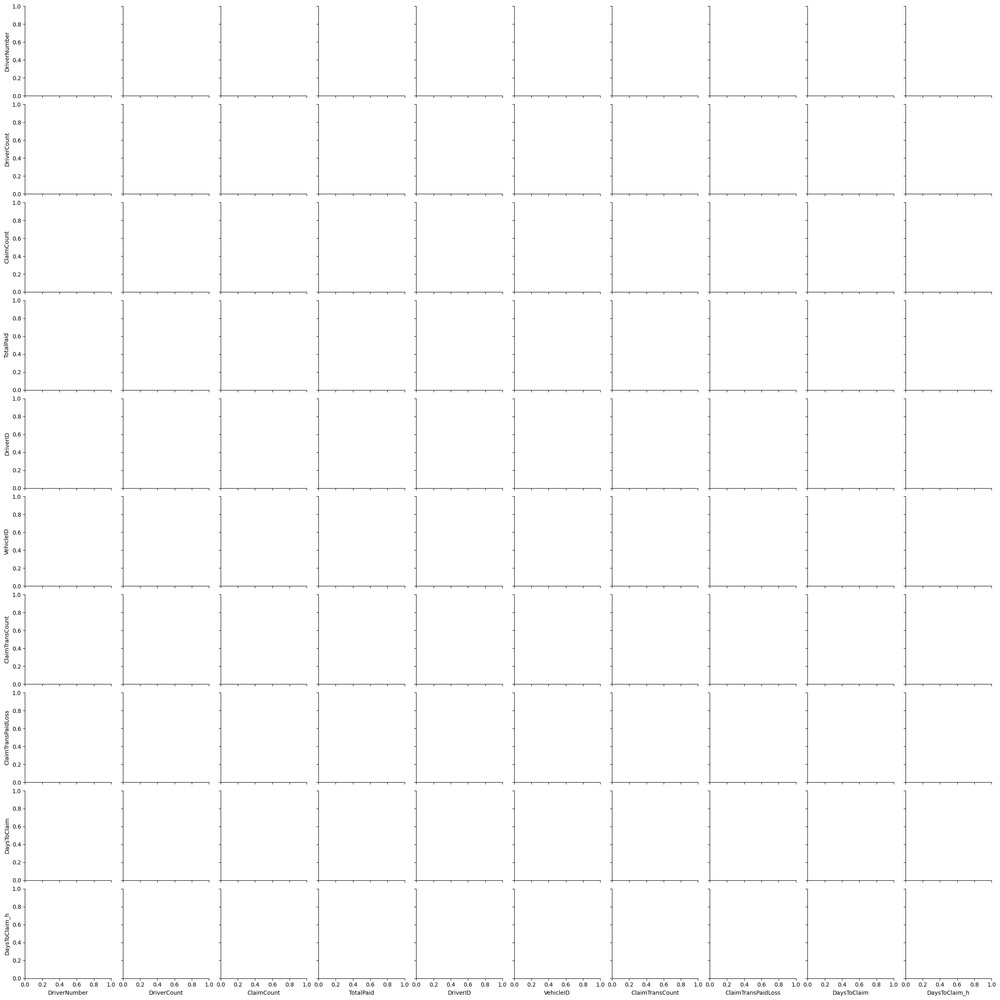

In [16]:
# Let's plot pair plot for checking relationship among variables
sns.pairplot(df_TheGeneral)

In [138]:
# Looking at look the numerical values. 
numerical_TheGeneral = df_TheGeneral.select_dtypes("number")
numerical_TheGeneral.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   DriverNumber        11069 non-null  int64  
 1   DriverCount         11069 non-null  int64  
 2   ClaimCount          11069 non-null  int64  
 3   TotalPaid           11069 non-null  float64
 4   DriverID            11069 non-null  int64  
 5   VehicleID           11069 non-null  int64  
 6   ClaimTransCount     9780 non-null   float64
 7   ClaimTransPaidLoss  9780 non-null   float64
 8   DaysToClaim         9780 non-null   float64
 9   DaysToClaim_h       9780 non-null   float64
dtypes: float64(5), int64(5)
memory usage: 864.9 KB


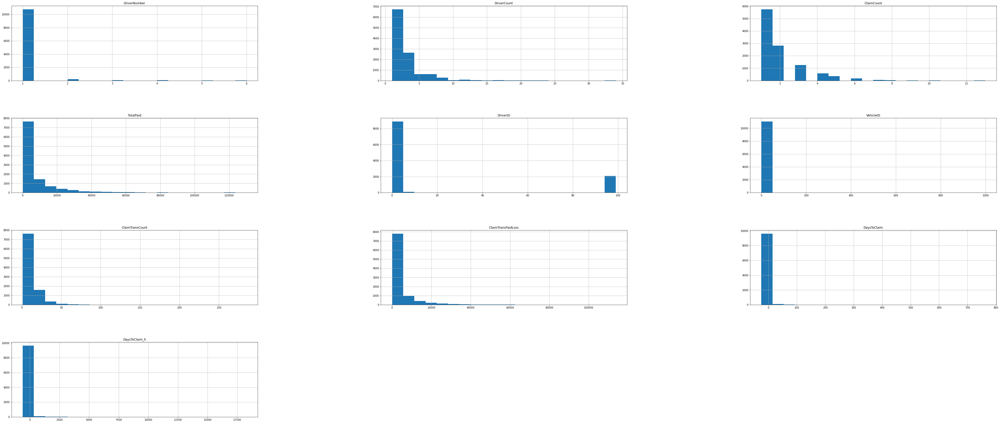

In [139]:
# Graphing all the numerical variables. 
numerical_TheGeneral.hist(bins=20, figsize=(70, 30))
plt.subplots_adjust(hspace=0.5, wspace=0.5)

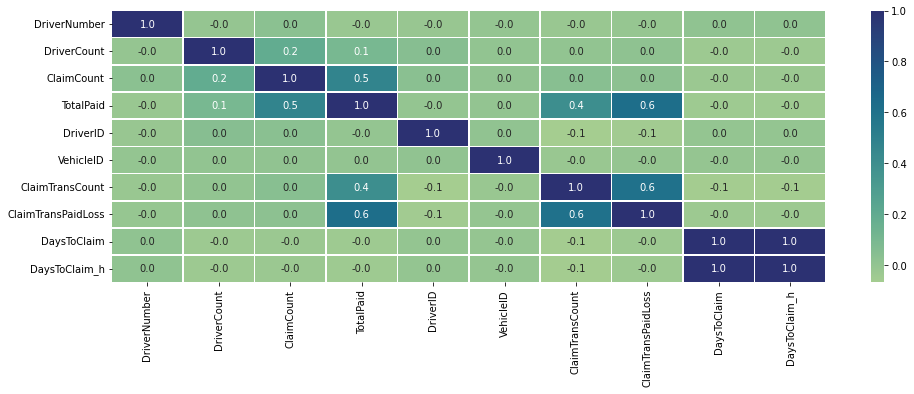

In [140]:
# Finally Let's draw heat map for having relationship between variables
corrmat = df_TheGeneral.corr()
plt.figure(figsize = (16,5))
sns.heatmap(corrmat,  annot=True, linewidth=.5, cmap="crest", fmt='.1f')
plt.show()

In [141]:
"""
So, we can see from above information there are some missing values
in TheGeneral dataset, which we will impute or drop in later section
also having look on heat map we can see relationship among variables
which will help us later for modeling
Let's now check for other data sets too
"""
df_MasterQuote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34975 entries, 0 to 34974
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   QuoteNumber                34975 non-null  object 
 1   MQuotedTotalPayment        34975 non-null  float64
 2   BiFcCoverageInd            34975 non-null  object 
 3   CoverageTypeDescription    34975 non-null  object 
 4   DriversActive              34975 non-null  int64  
 5   GaragingState              34975 non-null  object 
 6   NamedInsuredMaritalStatus  34975 non-null  object 
 7   PolicyNumber               21113 non-null  object 
 8   PolicyStateCode            34975 non-null  object 
 9   PolicyTerm                 34975 non-null  int64  
 10  QuoteInitiatedTime         34975 non-null  object 
 11  TermEffectiveDate          34975 non-null  object 
 12  TermExpirationDate         34975 non-null  object 
 13  AbilitecContactID          34975 non-null  obj

In [142]:
# Let's check for null values
df_MasterQuote.isnull().sum()

QuoteNumber                      0
MQuotedTotalPayment              0
BiFcCoverageInd                  0
CoverageTypeDescription          0
DriversActive                    0
GaragingState                    0
NamedInsuredMaritalStatus        0
PolicyNumber                 13862
PolicyStateCode                  0
PolicyTerm                       0
QuoteInitiatedTime               0
TermEffectiveDate                0
TermExpirationDate               0
AbilitecContactID                0
DriverNumber                     0
AbilitecHouseholdID              0
DriverCount                      0
dtype: int64

In [143]:
# let's now describe distribution of response variable with describe()
df_MasterQuote.MQuotedTotalPayment.describe()

count    34975.000000
mean      1554.266786
std       1232.290357
min          0.000000
25%        789.875000
50%       1260.000000
75%       2015.920000
max      18803.000000
Name: MQuotedTotalPayment, dtype: float64

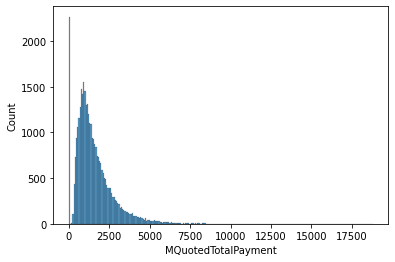

In [144]:
# Let's now plot histogram to see distribuition of data
sns.histplot(data=df_MasterQuote, x="MQuotedTotalPayment")

In [145]:
# Let's now check Skewness and Kurtosis
print(f"Skewness: {df_MasterQuote['MQuotedTotalPayment'].skew()}")
print(f"Kurtosis: {df_MasterQuote['MQuotedTotalPayment'].kurt()}")

Skewness: 2.479398703163955
Kurtosis: 13.673756524530756


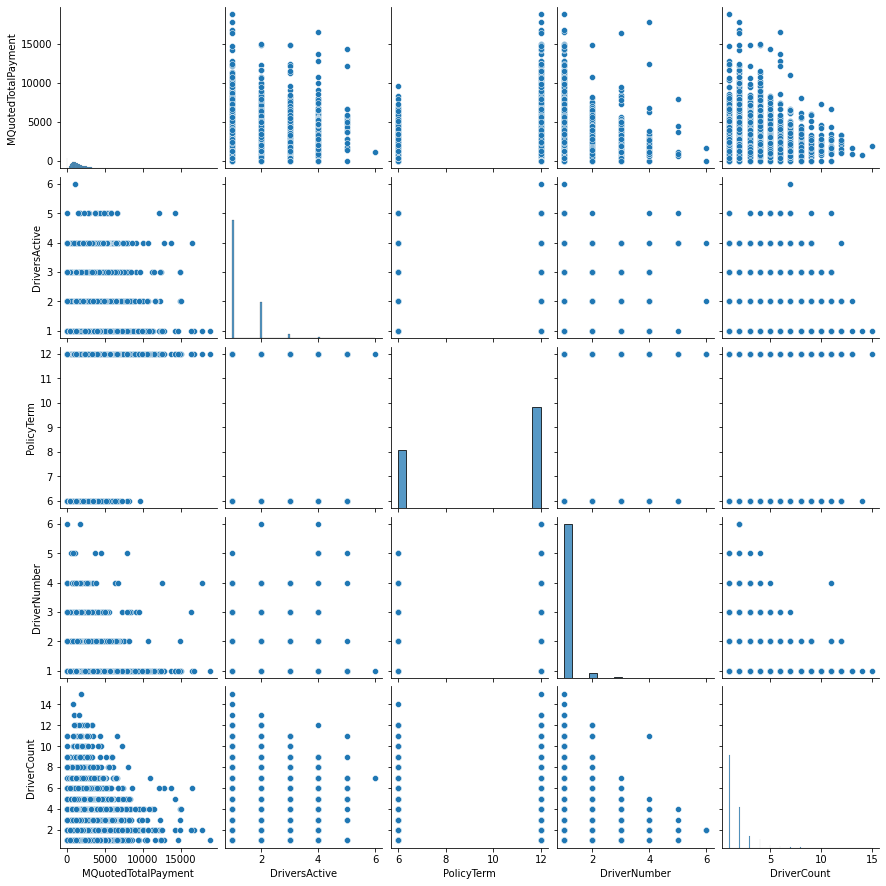

In [146]:
"""
As we can see skewness is 2.47 that means data is highly skewed
also from kurtosis value we can see distribuition is so peeked
Now let's check relationship with each variable
"""
sns.pairplot(df_MasterQuote)

In [28]:
# Looking at look the numerical values. 
numerical_MasterQuote = df_MasterQuote.select_dtypes("number")
numerical_MasterQuote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34975 entries, 0 to 34974
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   MQuotedTotalPayment  34975 non-null  float64
 1   DriversActive        34975 non-null  int64  
 2   PolicyTerm           34975 non-null  int64  
 3   DriverNumber         34975 non-null  int64  
 4   DriverCount          34975 non-null  int64  
dtypes: float64(1), int64(4)
memory usage: 1.3 MB


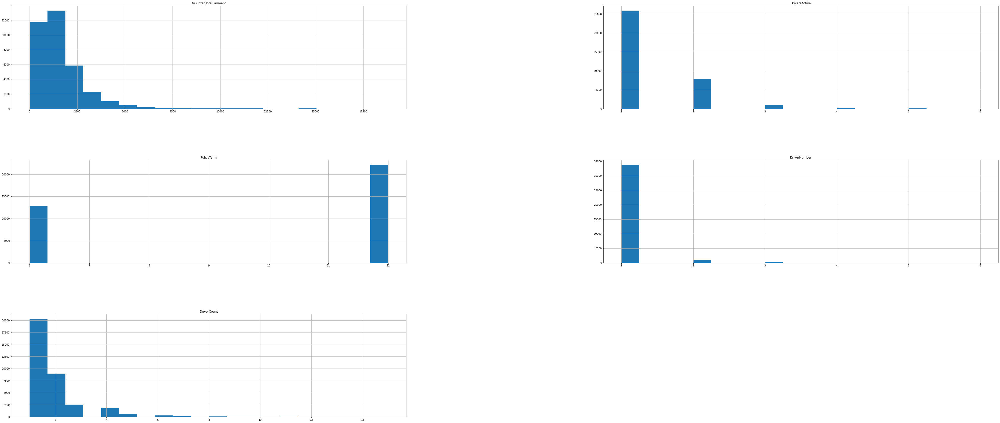

In [147]:
# Graphing all the numerical variables. 
numerical_MasterQuote.hist(bins=20, figsize=(70, 30))
plt.subplots_adjust(hspace=0.5, wspace=0.5)

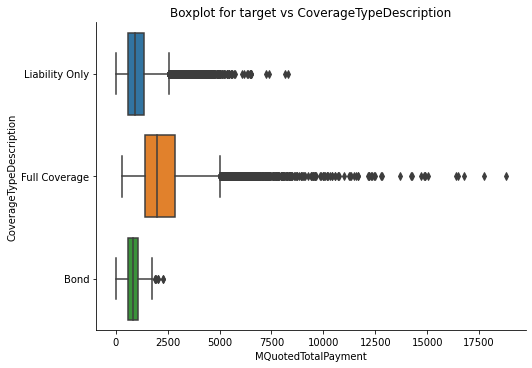

In [148]:
"""
Let's now visualize relationship of target variable with categorical
variables 
"""
sns.catplot(x="MQuotedTotalPayment", y="CoverageTypeDescription", data=df_MasterQuote, kind="box", aspect=1.5)
plt.title("Boxplot for target vs CoverageTypeDescription")
plt.show()

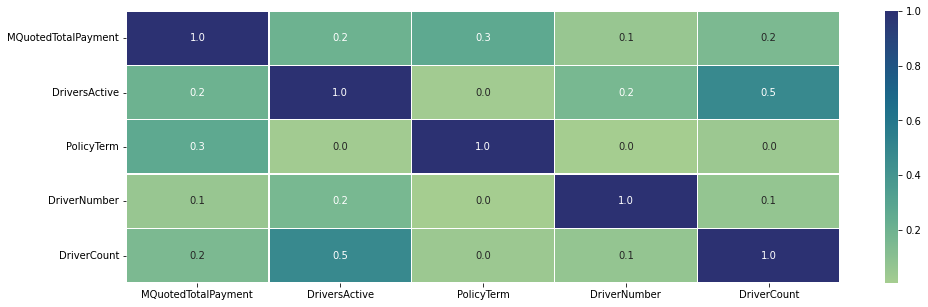

In [149]:
# Finally Let's draw heat map for having relationship between variables
corrmat = df_MasterQuote.corr()
plt.figure(figsize = (16,5))
sns.heatmap(corrmat,  annot=True, linewidth=.5, cmap="crest", fmt='.1f')
plt.show()

In [150]:
"""
Again from above information about masterQuote dataset, we can
see there are missing values in column 'PolicyNumber', again we
will impute or drop them in later section. also having look on heat map we can 
see relationship among variables which will help us later for modeling 
Let's now get insights about abilitech data set
"""
df_Abilitech.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96501 entries, 0 to 96500
Data columns (total 300 columns):
 #    Column                                                                                                                      Dtype  
---   ------                                                                                                                      -----  
 0    AbilitecContactID                                                                                                           object 
 1    ACX_ZIPCODE                                                                                                                 int64  
 2    ACX_ZIP4                                                                                                                    float64
 3    AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913                       float64
 4    AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_

In [151]:
df_Abilitech.isnull().sum()

AbilitecContactID                                                                                            0
ACX_ZIPCODE                                                                                                  0
ACX_ZIP4                                                                                                  4854
AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913    12419
AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_Of_181_To_225_Fin_rank_base_20_AP004916          12419
                                                                                                         ...  
AP005365_Aflac_Life_Insurance_Fin_rank_base_20_AP005365                                                  12419
AP005366_AIG_American_General_Life_Insurance_Fin_rank_base_20_AP005366                                   12419
AP005367_Allstate_Life_Insurance_Fin_rank_base_20_AP005367                                               12419
A

In [152]:
# Looking at look the numerical values. 
numerical_Abilitech = df_Abilitech.select_dtypes("number")
numerical_Abilitech.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96501 entries, 0 to 96500
Columns: 299 entries, ACX_ZIPCODE to AP005369_Bankers_Life_Causality_Life_Insurance_Fin_rank_base_20_AP005369
dtypes: float64(298), int64(1)
memory usage: 220.1 MB


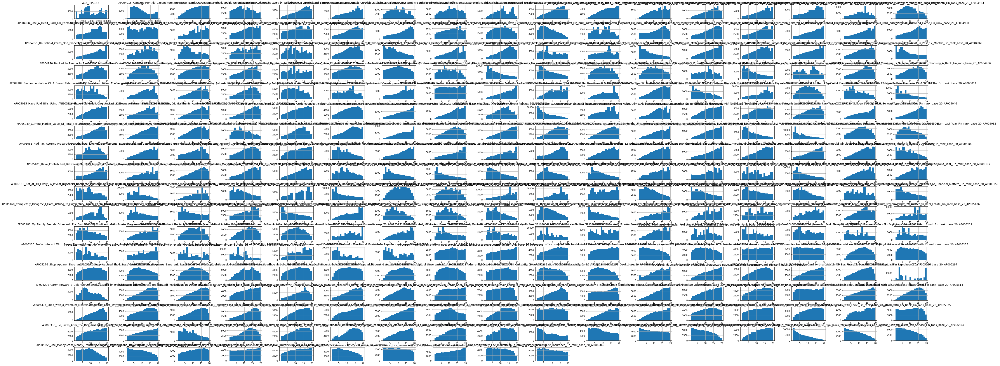

In [153]:
# Graphing all the numerical variables. 
numerical_Abilitech.hist(bins=20, figsize=(70, 30))
plt.subplots_adjust(hspace=0.5, wspace=0.5)

In [154]:
# Now let's check for variables that we can use from Abilitech data set
temp_Abilitech = pd.merge(df_MasterQuote[['MQuotedTotalPayment', 'AbilitecContactID']], df_Abilitech, on="AbilitecContactID")

In [155]:
numeric_cols = temp_Abilitech.select_dtypes("number")

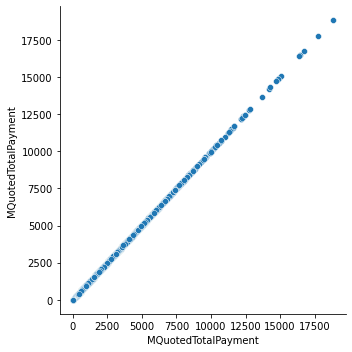

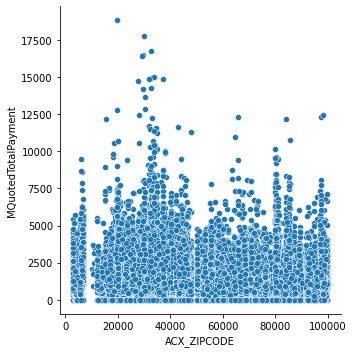

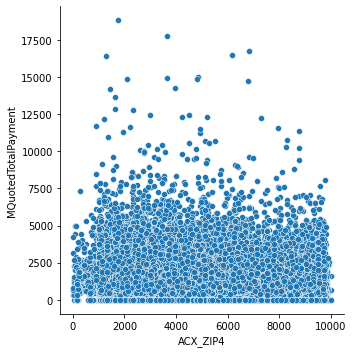

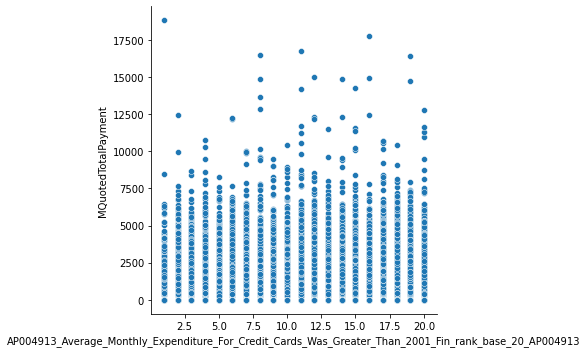

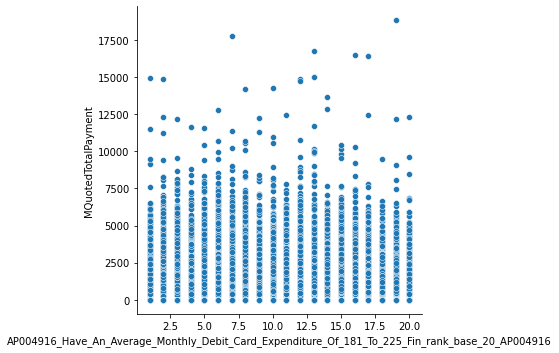

...

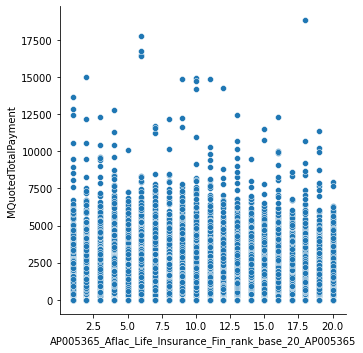

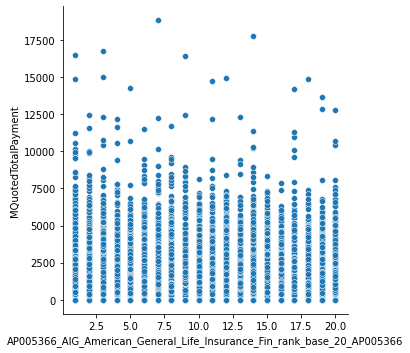

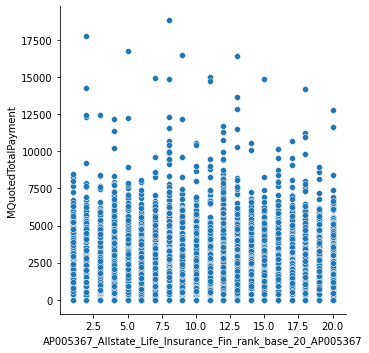

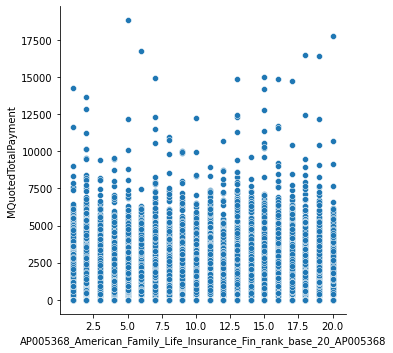

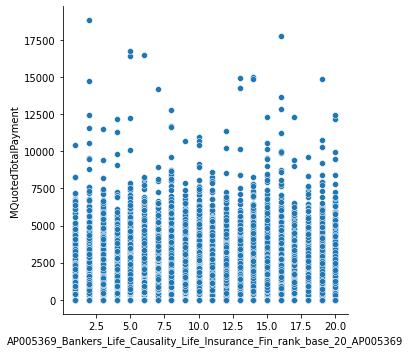

In [156]:
for col in numeric_cols:
  sns.relplot(col, 'MQuotedTotalPayment', data=temp_Abilitech)

Here we can see graphs we obtained shows no strong 
corelation of features from AbilitechData with response variable
so in exploratory analysis section, we have better insights of datasets,
total observations, data types, missing values and relationship among variables, we will now make use of this information for modeling

# 5. Modeling for predicting the MQuotedTotalPayment

## Cleaning Data set & modeling
In this section we will do following things

1.   Clean our dataset
2.   Impute missing values
3.   Create Dummy variables
4.   Scale our data set
5.   Create different modals
6.   compare them and report most important modal and features


In [157]:
df_MasterQuote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34975 entries, 0 to 34974
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   QuoteNumber                34975 non-null  object 
 1   MQuotedTotalPayment        34975 non-null  float64
 2   BiFcCoverageInd            34975 non-null  object 
 3   CoverageTypeDescription    34975 non-null  object 
 4   DriversActive              34975 non-null  int64  
 5   GaragingState              34975 non-null  object 
 6   NamedInsuredMaritalStatus  34975 non-null  object 
 7   PolicyNumber               21113 non-null  object 
 8   PolicyStateCode            34975 non-null  object 
 9   PolicyTerm                 34975 non-null  int64  
 10  QuoteInitiatedTime         34975 non-null  object 
 11  TermEffectiveDate          34975 non-null  object 
 12  TermExpirationDate         34975 non-null  object 
 13  AbilitecContactID          34975 non-null  obj

In [158]:
# Looking at look the categorical values. 
categorical_MasterQuote = df_MasterQuote.select_dtypes("object")
categorical_MasterQuote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34975 entries, 0 to 34974
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   QuoteNumber                34975 non-null  object
 1   BiFcCoverageInd            34975 non-null  object
 2   CoverageTypeDescription    34975 non-null  object
 3   GaragingState              34975 non-null  object
 4   NamedInsuredMaritalStatus  34975 non-null  object
 5   PolicyNumber               21113 non-null  object
 6   PolicyStateCode            34975 non-null  object
 7   QuoteInitiatedTime         34975 non-null  object
 8   TermEffectiveDate          34975 non-null  object
 9   TermExpirationDate         34975 non-null  object
 10  AbilitecContactID          34975 non-null  object
 11  AbilitecHouseholdID        34975 non-null  object
dtypes: object(12)
memory usage: 3.2+ MB


In [159]:
# Let's Now label encode our coulmns having type object
lb = LabelEncoder()  

In [160]:
"""

we will drop those policy numbers having nan values 
because we can't simply impute them by most common one

"""
df_MasterQuote.dropna(inplace=True)
df_MasterQuote.reset_index(drop=True, inplace=True)

In [161]:
df_MasterQuote.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21113 entries, 0 to 21112
Data columns (total 17 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   QuoteNumber                21113 non-null  object 
 1   MQuotedTotalPayment        21113 non-null  float64
 2   BiFcCoverageInd            21113 non-null  object 
 3   CoverageTypeDescription    21113 non-null  object 
 4   DriversActive              21113 non-null  int64  
 5   GaragingState              21113 non-null  object 
 6   NamedInsuredMaritalStatus  21113 non-null  object 
 7   PolicyNumber               21113 non-null  object 
 8   PolicyStateCode            21113 non-null  object 
 9   PolicyTerm                 21113 non-null  int64  
 10  QuoteInitiatedTime         21113 non-null  object 
 11  TermEffectiveDate          21113 non-null  object 
 12  TermExpirationDate         21113 non-null  object 
 13  AbilitecContactID          21113 non-null  obj

In [162]:
# creating dummy variables now
dummy_var_cols = ['CoverageTypeDescription', 'BiFcCoverageInd', 'GaragingState', 
              'NamedInsuredMaritalStatus', 'PolicyStateCode']
dummies = df_MasterQuote[dummy_var_cols]

In [163]:
dummies_df = pd.get_dummies(dummies)

In [164]:
dummies_df.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21113 entries, 0 to 21112
Data columns (total 108 columns):
 #    Column                                      Dtype
---   ------                                      -----
 0    CoverageTypeDescription_Bond                uint8
 1    CoverageTypeDescription_Full Coverage       uint8
 2    CoverageTypeDescription_Liability Only      uint8
 3    BiFcCoverageInd_BI FC                       uint8
 4    BiFcCoverageInd_BI NOFC                     uint8
 5    BiFcCoverageInd_NOBI FC                     uint8
 6    BiFcCoverageInd_NOBI NOFC                   uint8
 7    GaragingState_AK                            uint8
 8    GaragingState_AL                            uint8
 9    GaragingState_AR                            uint8
 10   GaragingState_AZ                            uint8
 11   GaragingState_CA                            uint8
 12   GaragingState_CO                            uint8
 13   GaragingState_CT                            

In [165]:
# Now let's label encode data
categorical_vars = [col for col in list(df_MasterQuote.select_dtypes(['object']).columns) if col not in dummy_var_cols]

In [166]:
categorical_vars.remove('AbilitecContactID')

In [167]:
categorical_vars

['QuoteNumber',
 'PolicyNumber',
 'QuoteInitiatedTime',
 'TermEffectiveDate',
 'TermExpirationDate',
 'AbilitecHouseholdID']

In [168]:
for col in categorical_vars:
  df_MasterQuote[col] = lb.fit_transform(df_MasterQuote[col])

In [169]:
# Dropping dummy variables
df_MasterQuote.drop(dummy_var_cols, inplace=True, axis=1)

In [170]:
df_MasterQuote.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21113 entries, 0 to 21112
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   QuoteNumber          21113 non-null  int64  
 1   MQuotedTotalPayment  21113 non-null  float64
 2   DriversActive        21113 non-null  int64  
 3   PolicyNumber         21113 non-null  int64  
 4   PolicyTerm           21113 non-null  int64  
 5   QuoteInitiatedTime   21113 non-null  int64  
 6   TermEffectiveDate    21113 non-null  int64  
 7   TermExpirationDate   21113 non-null  int64  
 8   AbilitecContactID    21113 non-null  object 
 9   DriverNumber         21113 non-null  int64  
 10  AbilitecHouseholdID  21113 non-null  int64  
 11  DriverCount          21113 non-null  int64  
dtypes: float64(1), int64(10), object(1)
memory usage: 1.9+ MB


In [171]:
# Let's now merge dummy variables with data Frame
df_MasterQuote = pd.concat([df_MasterQuote, dummies_df], axis=1)

In [172]:
df_MasterQuote.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21113 entries, 0 to 21112
Data columns (total 120 columns):
 #    Column                                      Dtype  
---   ------                                      -----  
 0    QuoteNumber                                 int64  
 1    MQuotedTotalPayment                         float64
 2    DriversActive                               int64  
 3    PolicyNumber                                int64  
 4    PolicyTerm                                  int64  
 5    QuoteInitiatedTime                          int64  
 6    TermEffectiveDate                           int64  
 7    TermExpirationDate                          int64  
 8    AbilitecContactID                           object 
 9    DriverNumber                                int64  
 10   AbilitecHouseholdID                         int64  
 11   DriverCount                                 int64  
 12   CoverageTypeDescription_Bond                uint8  
 13   CoverageTypeDe

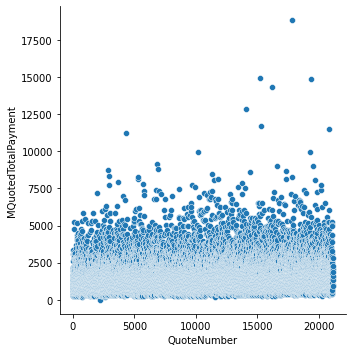

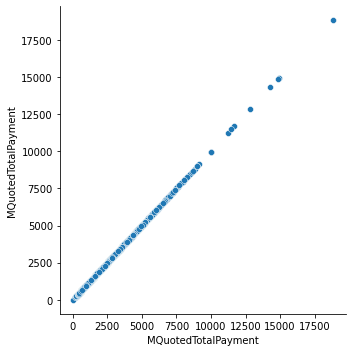

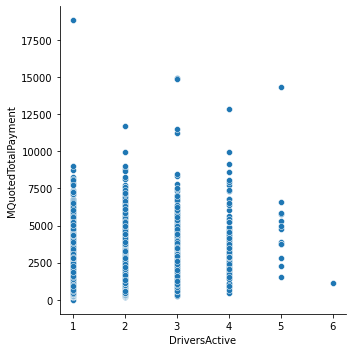

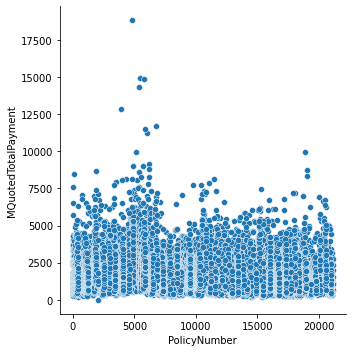

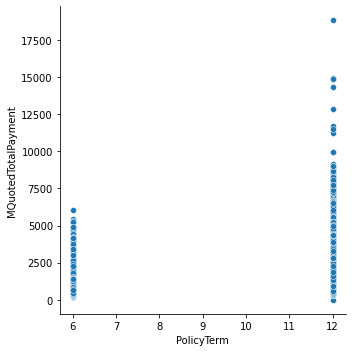

...

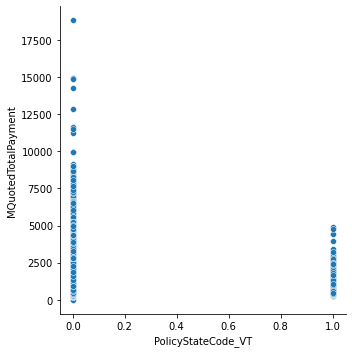

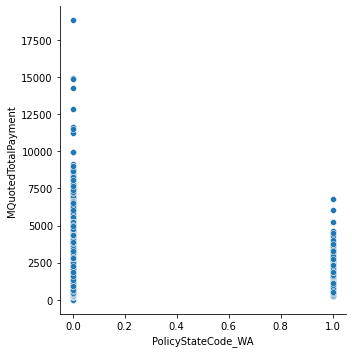

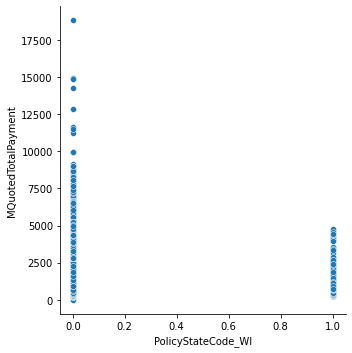

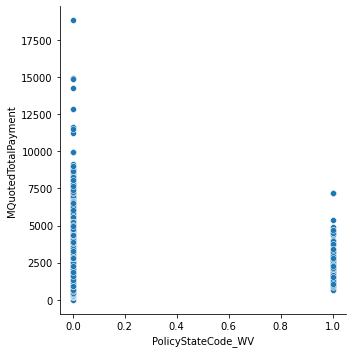

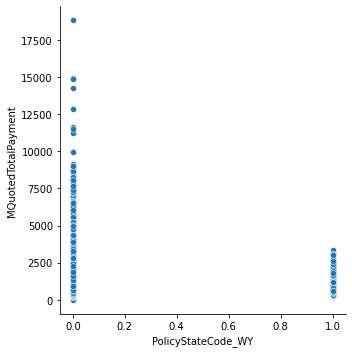

In [173]:
# Let's now check relationship of predictor with response variable
for col in df_MasterQuote.columns:
  if col is not 'AbilitecContactID':
    sns.relplot(col, 'MQuotedTotalPayment', data=df_MasterQuote)


In [174]:
# Removing un necessary predictors
df_MasterQuote.drop(['DriversActive', 'PolicyTerm'], inplace=True, axis=1)

In [175]:
"""
Our MasterQuoteData is now prepared
Let's now make use of abilitech dataset
combine both of them for modeling
"""
# Looking at numeric variables
# Looking at look the categorical values. 
categorical_Abilitech = df_Abilitech.select_dtypes("object")
numeric_Abilitech = df_Abilitech.select_dtypes("number")

In [176]:
categorical_Abilitech.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96501 entries, 0 to 96500
Data columns (total 1 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   AbilitecContactID  96501 non-null  object
dtypes: object(1)
memory usage: 754.0+ KB


In [177]:
features_with_missing_values = [col for col in numeric_Abilitech.columns if numeric_Abilitech[col].isnull().sum() > 0]

In [178]:
#Let's now impute data by mean
for col in features_with_missing_values:
  numeric_Abilitech[col].fillna(numeric_Abilitech[col].mean(), inplace=True)

In [179]:
numeric_Abilitech.isnull().sum()

ACX_ZIPCODE                                                                                              0
ACX_ZIP4                                                                                                 0
AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913    0
AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_Of_181_To_225_Fin_rank_base_20_AP004916          0
AP004921_Never_Or_Rarely_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004921                      0
                                                                                                        ..
AP005365_Aflac_Life_Insurance_Fin_rank_base_20_AP005365                                                  0
AP005366_AIG_American_General_Life_Insurance_Fin_rank_base_20_AP005366                                   0
AP005367_Allstate_Life_Insurance_Fin_rank_base_20_AP005367                                               0
AP005368_American_Family_Life_Insuran

In [180]:
# Let's now concat both data frames
numeric_Abilitech.columns

Index(['ACX_ZIPCODE', 'ACX_ZIP4',
       'AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913',
       'AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_Of_181_To_225_Fin_rank_base_20_AP004916',
       'AP004921_Never_Or_Rarely_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004921',
       'AP004922_Sometimes_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004922',
       'AP004923_Usually_Or_Always_Carry_A_Balance_On_A_Credit_Card_Fin_rank_base_20_AP004923',
       'AP004924_Have_Accepted_Pre_Approved_Credit_Card_Offer_In_Past_12_Months_Fin_rank_base_20_AP004924',
       'AP004925_Have_Used_Credit_Cards_For_Business_Purposes_Fin_rank_base_20_AP004925',
       'AP004926_Have_Used_Credit_Cards_For_Personal_Purposes_Fin_rank_base_20_AP004926',
       ...
       'AP005355_Use_MoneyGram_Money_Transfer_Services_Fin_rank_base_20_AP005355',
       'AP005356_Use_Other_Online_Tax_Program_Service_Fin_rank_base_20_AP005356',
      

In [181]:
df_Abilitech = pd.concat([categorical_Abilitech, numeric_Abilitech], axis=1)
df_Abilitech.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96501 entries, 0 to 96500
Data columns (total 300 columns):
 #    Column                                                                                                                      Dtype  
---   ------                                                                                                                      -----  
 0    AbilitecContactID                                                                                                           object 
 1    ACX_ZIPCODE                                                                                                                 int64  
 2    ACX_ZIP4                                                                                                                    float64
 3    AP004913_Average_Monthly_Expenditure_For_Credit_Cards_Was_Greater_Than_2001_Fin_rank_base_20_AP004913                       float64
 4    AP004916_Have_An_Average_Monthly_Debit_Card_Expenditure_

## Merging Abilitech and MasterQuote Dataset
in below section we will merge our datasets for regression

In [182]:
# Let's now join datasets on AbilitechContactId
df_final = pd.merge(df_MasterQuote, df_Abilitech, on="AbilitecContactID")

In [183]:
df_final['AbilitecContactID'] = lb.fit_transform(df_final['AbilitecContactID'])

In [184]:
df_final.info(all)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21113 entries, 0 to 21112
Data columns (total 417 columns):
 #    Column                                                                                                                      Dtype  
---   ------                                                                                                                      -----  
 0    QuoteNumber                                                                                                                 int64  
 1    MQuotedTotalPayment                                                                                                         float64
 2    PolicyNumber                                                                                                                int64  
 3    QuoteInitiatedTime                                                                                                          int64  
 4    TermEffectiveDate                                       

In [185]:
# Let's now divide Data set into training and testing 
X = df_final.drop('MQuotedTotalPayment', axis=1)
y = df_final.MQuotedTotalPayment

## Splitting Data set

In this section, we will split data set, standarize our data
and fit modal on it

In [186]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=33)

## Standarizing Data

In [189]:
# Let's now scale our data set
sc = StandardScaler()
sc.fit(X)

StandardScaler()

In [190]:
X_train_sc = sc.transform(X_train)
X_test_sc = sc.transform(X_test)

## Fitting Multiple Linear Regression Modal

In [191]:
# Let's now fit multi linear regression modal
regr = linear_model.LinearRegression()
regr.fit(X_train_sc, y_train)

LinearRegression()

In [192]:
y_pred = regr.predict(X_test_sc)

In [193]:
def stats(y, y_pred):
  test_mse = mean_squared_error(y, y_pred)
  test_rmse = np.sqrt(test_mse)
  test_mae = mean_absolute_error(y, y_pred)
  test_r_squared = r2_score(y, y_pred)
  test_mape = mean_absolute_percentage_error(y, y_pred)
  print(f' the test MSE is:{test_mse}')
  print(f' the test RMSE is:{test_rmse}')
  print(f' the test MAE is:{test_mae}')
  print(f' the test Rsquared is:{test_r_squared}')
  print(f' the test MAPE is:{test_mape}')


In [194]:
stats(y_test, y_pred)

 the test MSE is:512465.05931211624
 the test RMSE is:715.866649112889
 the test MAE is:489.2836154702212
 the test Rsquared is:0.5231513908931398
 the test MAPE is:731639562129368.1


here we can see Accuracy of modal is 52% 

## Fitting Ridge Regression


In [195]:
ridge_regression = Ridge(alpha=1.0)
ridge_regression.fit(X_train_sc, y_train)


Ridge()

In [196]:
y_pred = ridge_regression.predict(X_test_sc)

In [197]:
stats(y_test, y_pred)

 the test MSE is:512421.38924148364
 the test RMSE is:715.8361469229419
 the test MAE is:489.13467424424255
 the test Rsquared is:0.5231920258829061
 the test MAPE is:731811266941955.5


## Fitting Lasso Regression


In [198]:
lasso_regression = Lasso(alpha=0.5)
lasso_regression.fit(X_train_sc, y_train)

Lasso(alpha=0.5)

In [199]:
y_pred = lasso_regression.predict(X_test_sc)

In [200]:
stats(y_test, y_pred)

 the test MSE is:508198.4659203423
 the test RMSE is:712.8804008530059
 the test MAE is:484.8283739597531
 the test Rsquared is:0.5271214549736507
 the test MAPE is:719881968310313.1


## Modal Analysis
From above regression models, we can see Lasso works better having around 53% of accuracy as compared to Ridge and Multiple Linear Regression

## Feature Selection


In [201]:
def select_features(X_train, y_train, X_test):
 # configure to select all features
 fs = SelectKBest(score_func=f_regression, k='all')
 # learn relationship from training data
 fs.fit(X_train, y_train)
 # transform train input data
 X_train_fs = fs.transform(X_train)
 # transform test input data
 X_test_fs = fs.transform(X_test)
 return X_train_fs, X_test_fs, fs

In [202]:
# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train_sc, y_train, X_test_sc)
# fit the model
model = linear_model.LinearRegression()
model.fit(X_train_fs, y_train)
# evaluate the model
yhat = model.predict(X_test_fs)

## Plotting Best Features


Feature 0: 187.734226


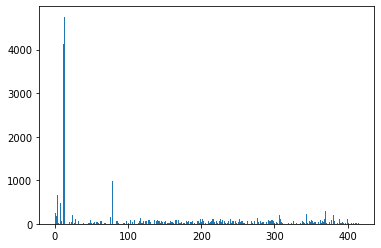

Feature 1: 246.185395


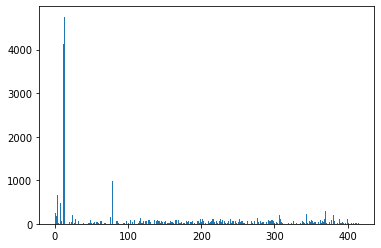

Feature 2: 186.817291


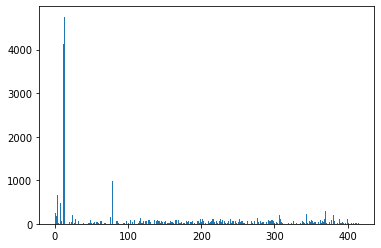

Feature 3: 202.377981


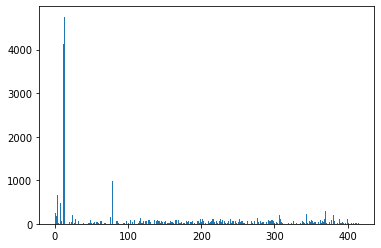

Feature 4: 657.505933


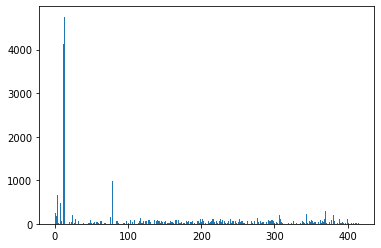

Feature 5: 10.765408


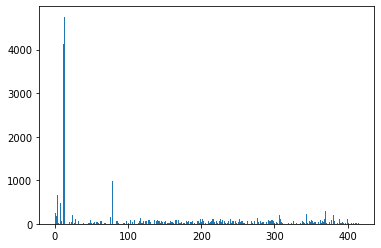

Feature 6: 0.879182


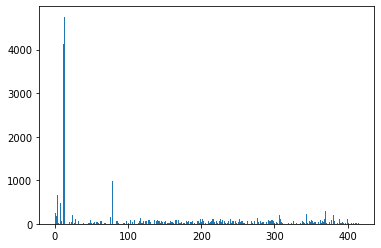

Feature 7: 8.220387


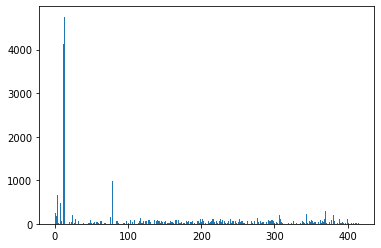

Feature 8: 482.849882


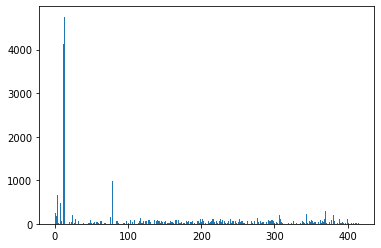

Feature 9: 53.034356


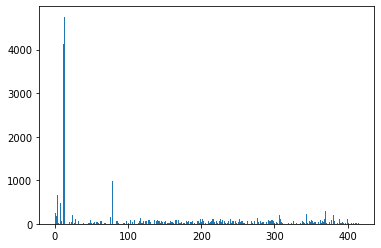

Feature 10: 4706.028059


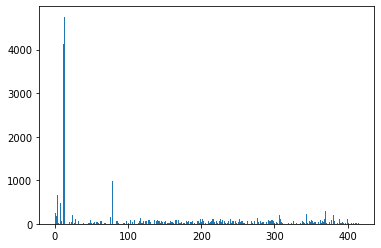

Feature 11: 4387.349762


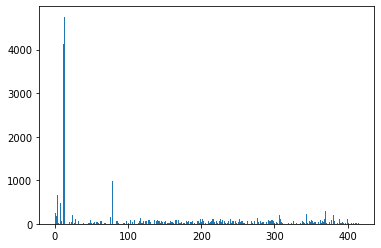

Feature 12: 4121.851244


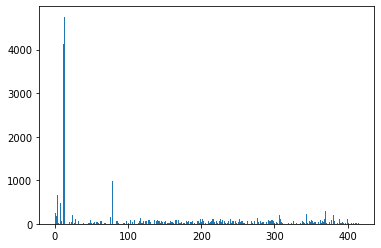

Feature 13: 4753.833804


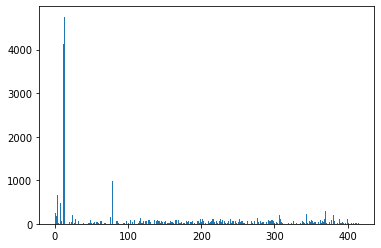

Feature 14: 252.493805


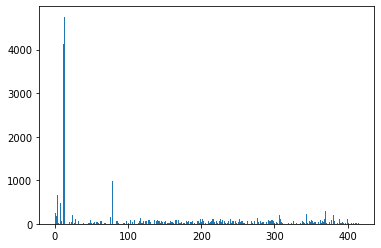

Feature 15: 7.647805


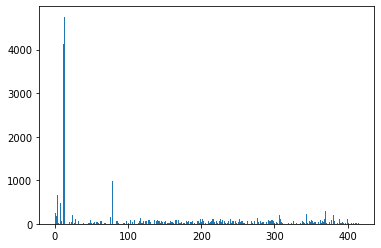

Feature 16: 5.912669


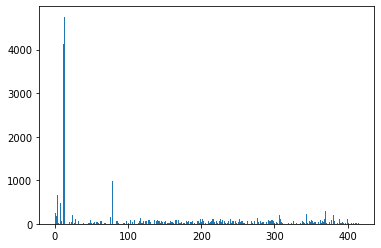

Feature 17: 0.116585


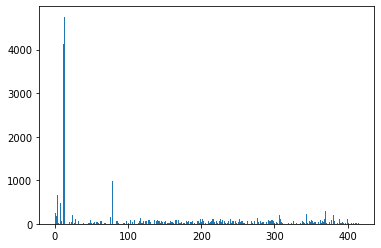

Feature 18: 2.306854


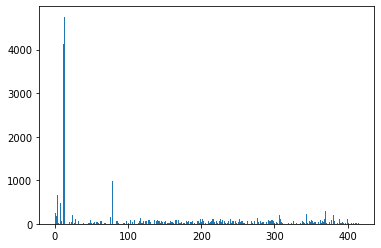

Feature 19: 3.820796


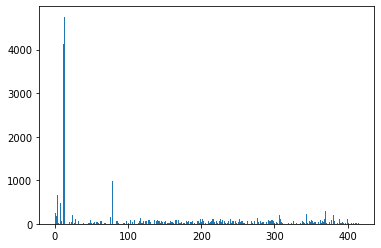

Feature 20: 36.979515


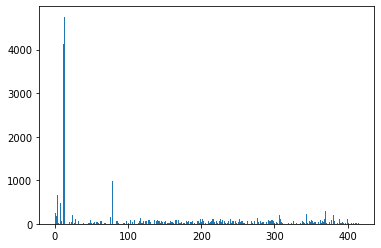

Feature 21: 1.315860


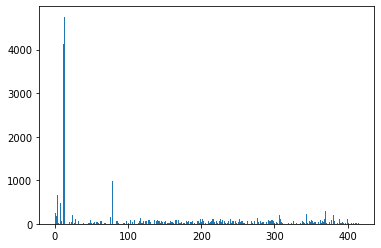

Feature 22: 148.779094


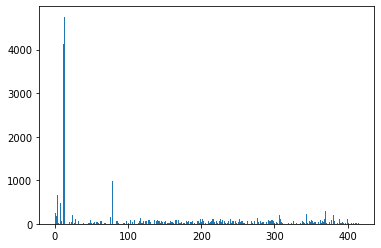

Feature 23: 50.384600


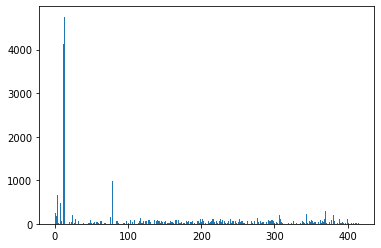

Feature 24: 198.127942


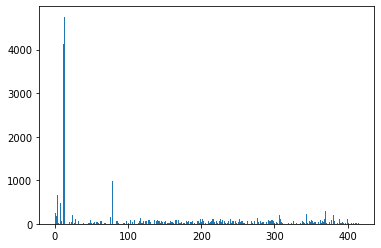

Feature 25: 984.653860


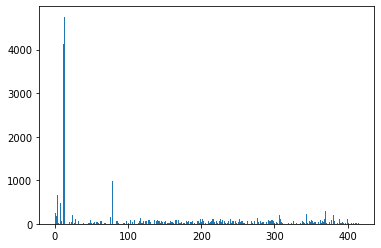

Feature 26: 0.034319


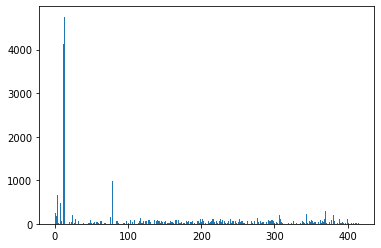

Feature 27: 14.630315


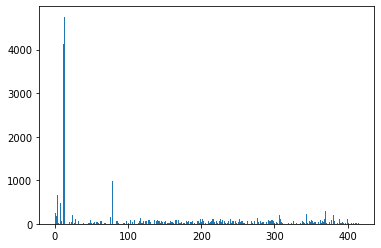

Feature 28: 117.272559


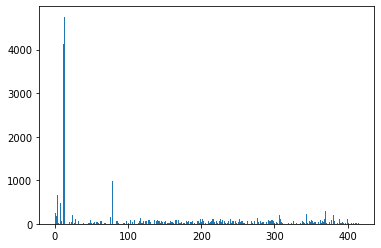

Feature 29: 0.510868


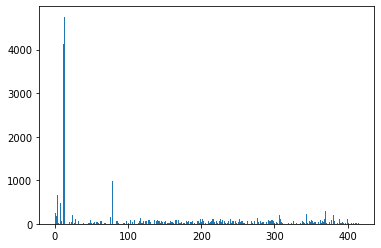

Feature 30: 55.826738


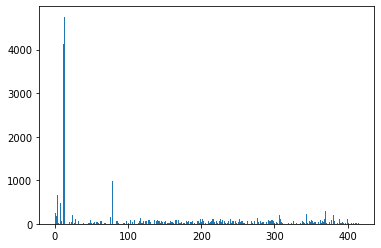

Feature 31: 0.166652


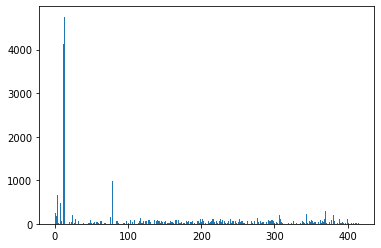

Feature 32: 60.403357


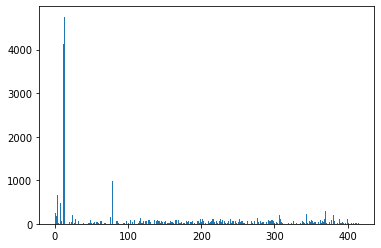

Feature 33: 21.987842


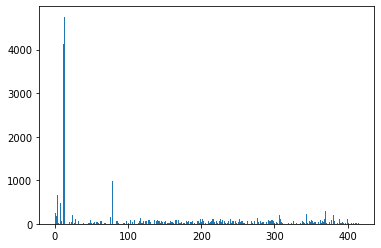

Feature 34: 3.082590


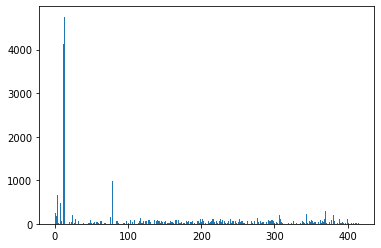

Feature 35: 4.395621


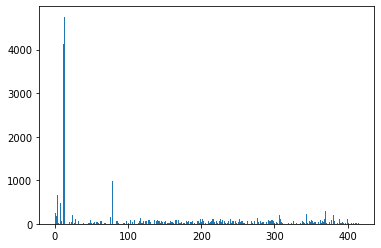

Feature 36: 0.583657


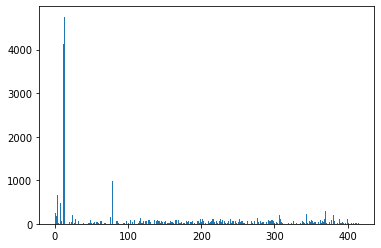

Feature 37: 0.085159


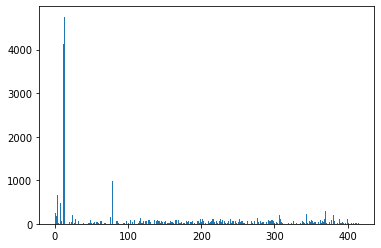

Feature 38: 0.708776


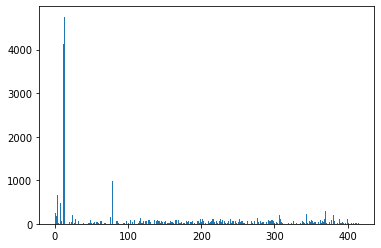

Feature 39: 26.471865


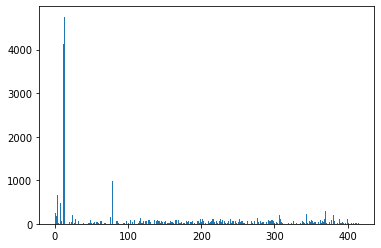

Feature 40: 26.460297


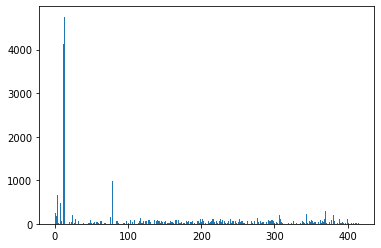

Feature 41: 7.188617


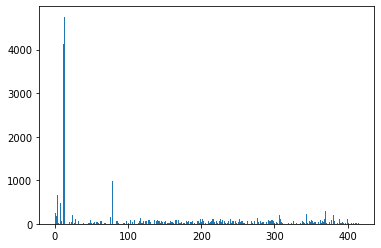

Feature 42: 1.007805


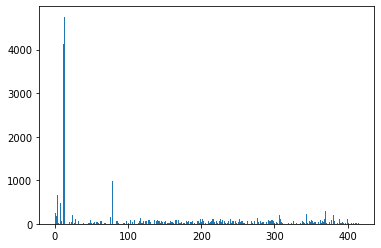

Feature 43: 4.177536


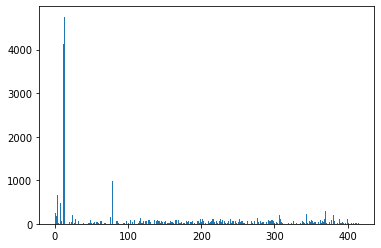

Feature 44: 60.230307


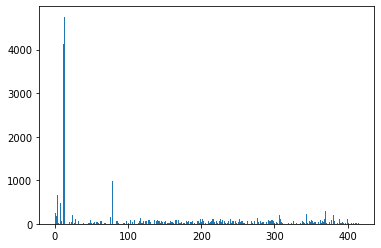

Feature 45: 0.030211


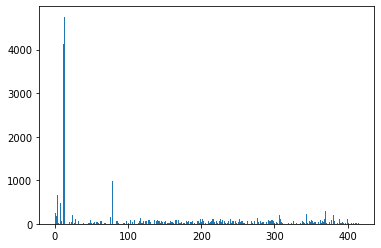

Feature 46: 21.739556


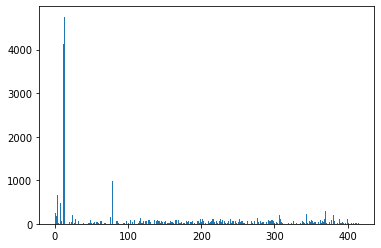

Feature 47: 21.423415


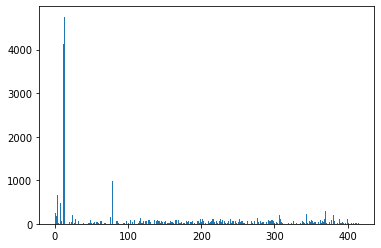

Feature 48: 2.298817


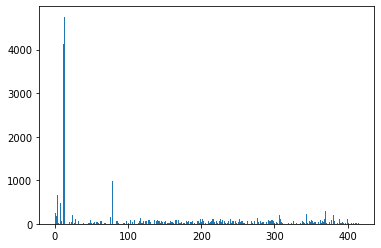

Feature 49: 85.177057


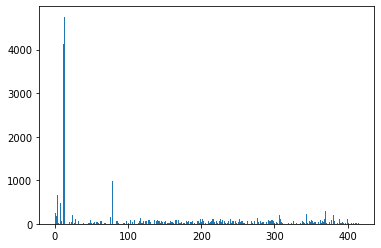

Feature 50: 11.409025


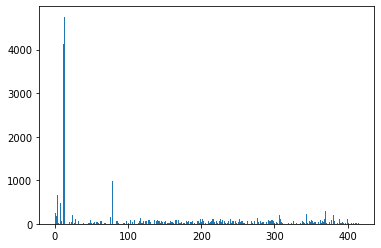

Feature 51: 0.292315


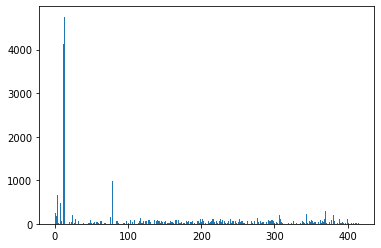

Feature 52: 52.036322


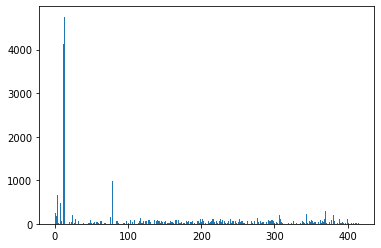

Feature 53: 27.007930


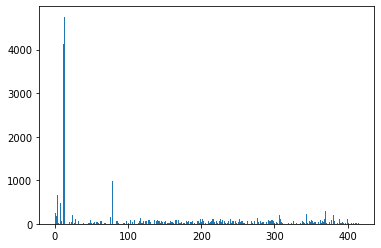

Feature 54: 31.231526


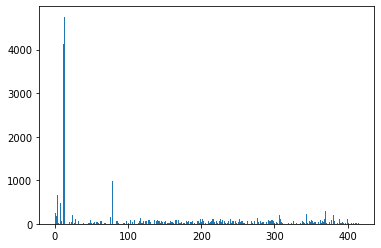

Feature 55: 94.451951


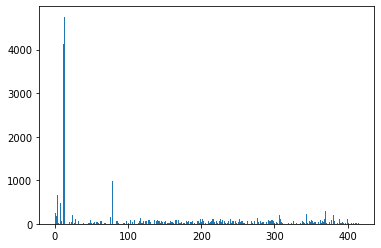

Feature 56: 3.064525


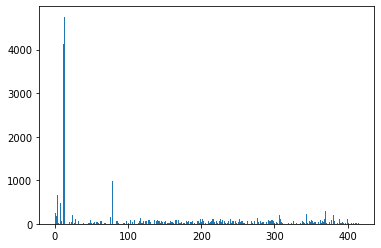

Feature 57: 34.182487


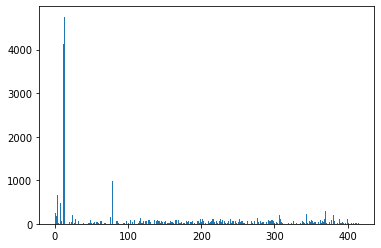

Feature 58: 40.857696


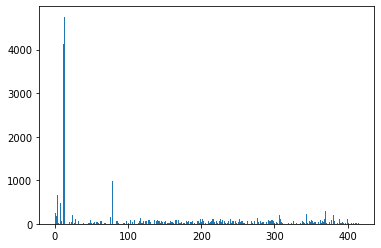

Feature 59: 1.584223


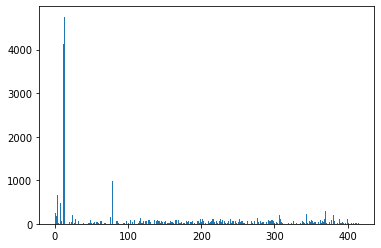

Feature 60: 26.138956


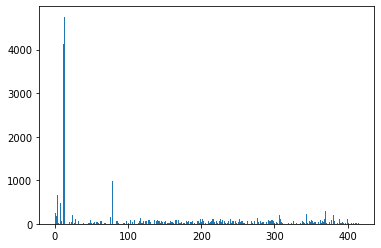

Feature 61: 5.197342


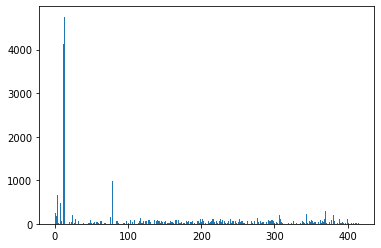

Feature 62: 63.473479


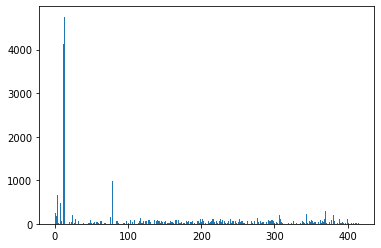

Feature 63: 1.493890


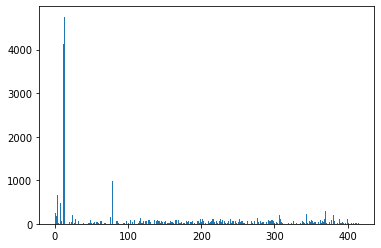

Feature 64: 63.678547


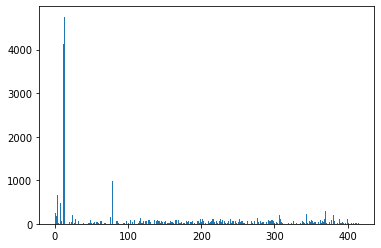

Feature 65: 0.340925


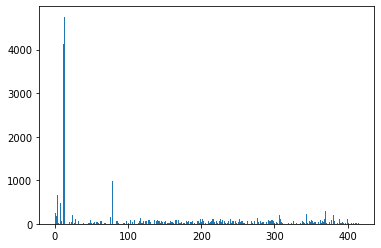

Feature 66: 93.402842


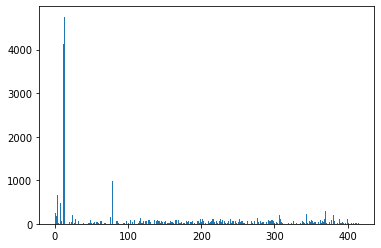

Feature 67: 9.162819


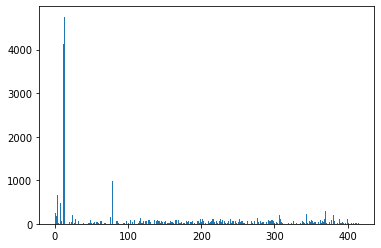

Feature 68: 8.050461


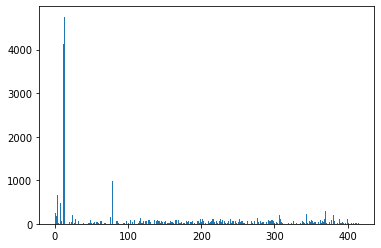

Feature 69: 13.078513


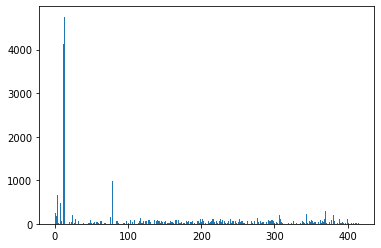

Feature 70: 5.912669


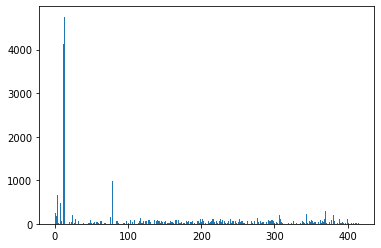

Feature 71: 0.116585


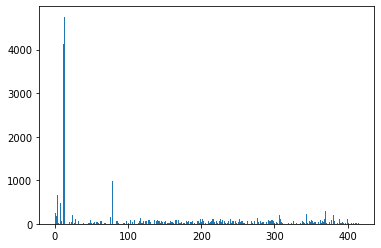

Feature 72: 2.306854


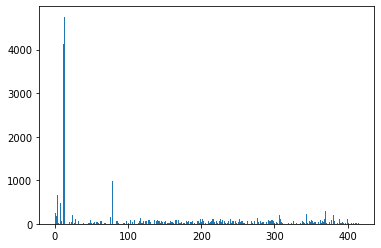

Feature 73: 3.820796


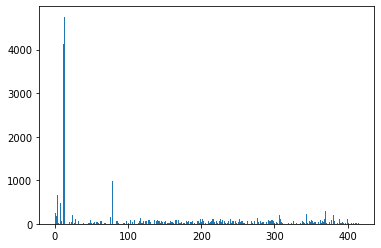

Feature 74: 36.979515


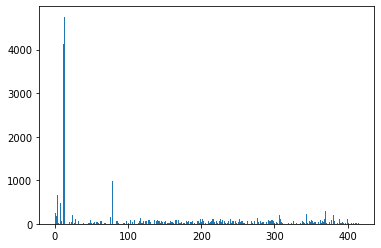

Feature 75: 1.315860


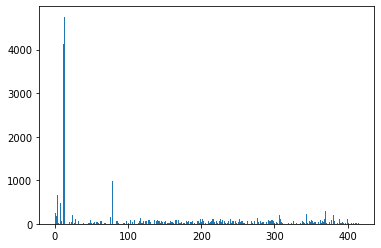

Feature 76: 148.779094


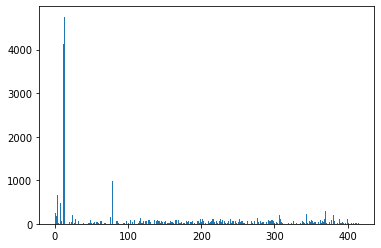

Feature 77: 50.384600


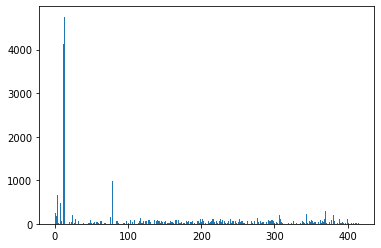

Feature 78: 198.127942


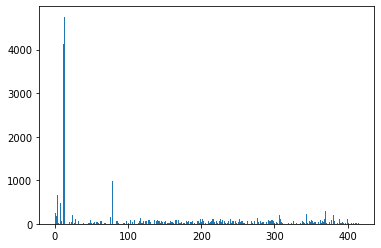

Feature 79: 984.653860


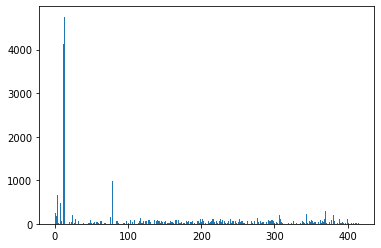

Feature 80: 0.034319


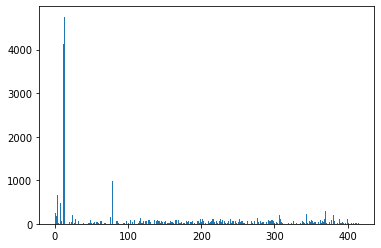

Feature 81: 14.630315


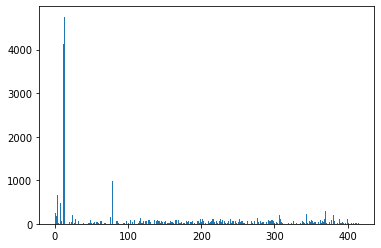

Feature 82: 117.272559


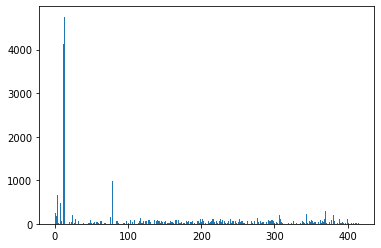

Feature 83: 0.510868


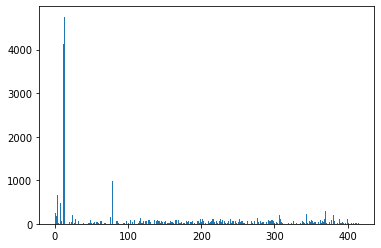

Feature 84: 55.826738


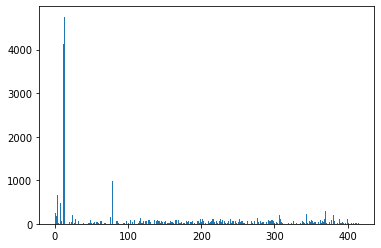

Feature 85: 0.166652


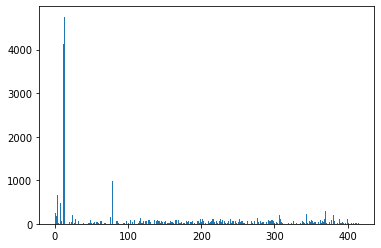

Feature 86: 60.403357


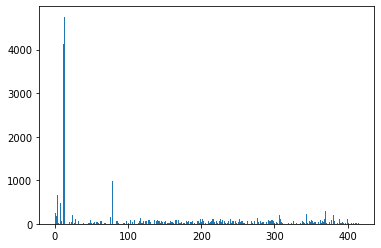

Feature 87: 21.987842


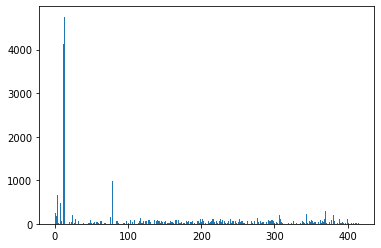

Feature 88: 3.082590


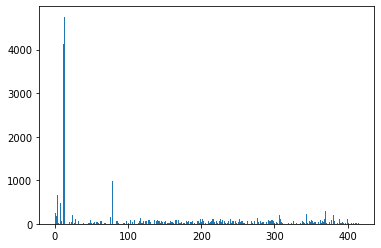

Feature 89: 4.395621


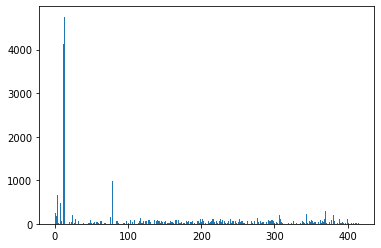

Feature 90: 0.583657


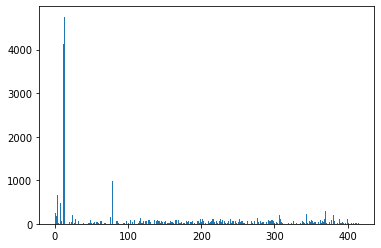

Feature 91: 0.085159


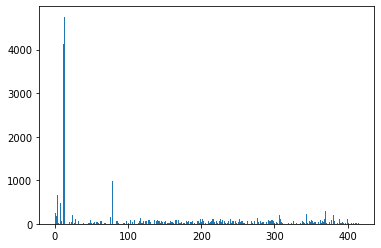

Feature 92: 0.708776


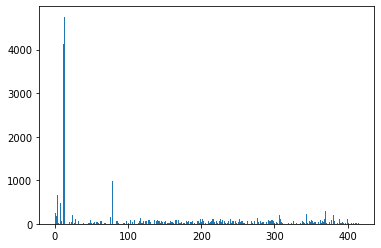

Feature 93: 26.471865


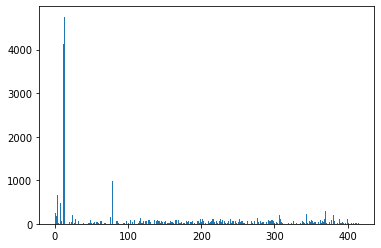

Feature 94: 26.460297


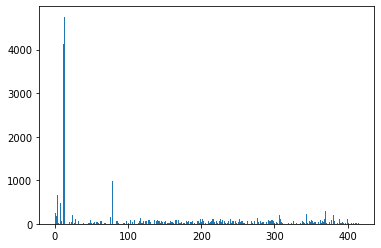

Feature 95: 7.188617


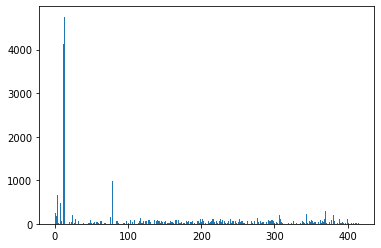

Feature 96: 1.007805


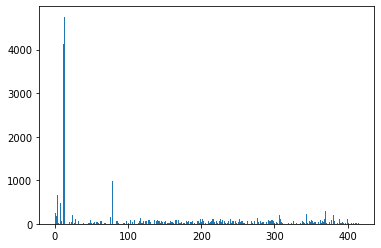

Feature 97: 4.177536


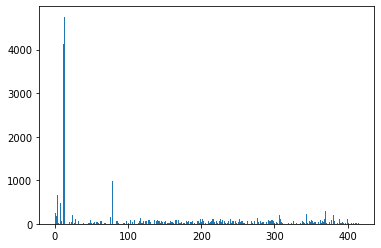

Feature 98: 60.230307


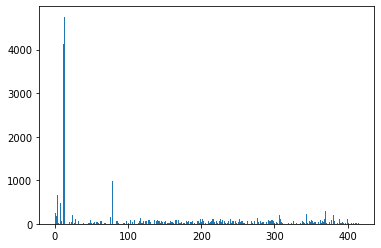

Feature 99: 0.030211


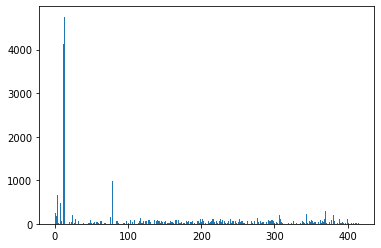

Feature 100: 21.739556


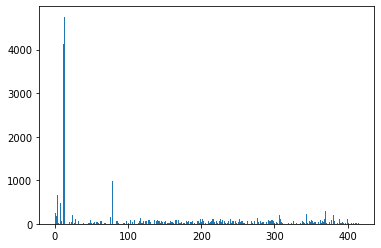

Feature 101: 21.423415


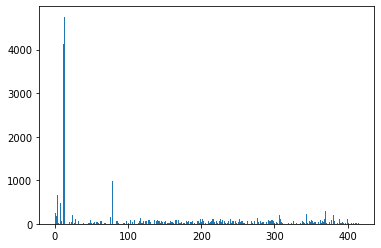

Feature 102: 2.298817


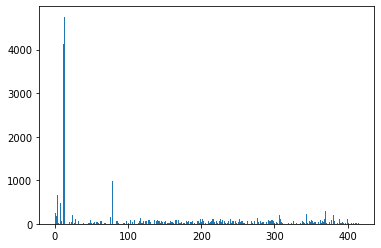

Feature 103: 85.177057


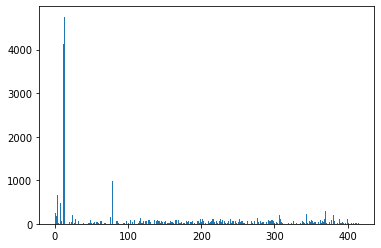

Feature 104: 11.409025


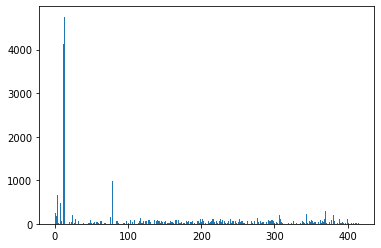

Feature 105: 0.292315


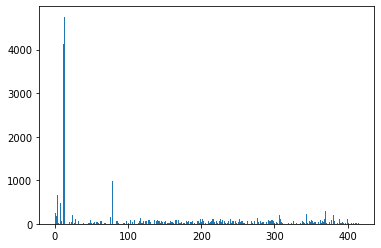

Feature 106: 52.036322


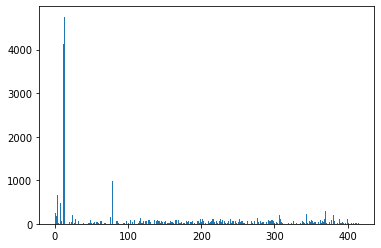

Feature 107: 27.007930


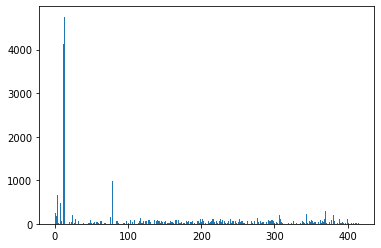

Feature 108: 31.231526


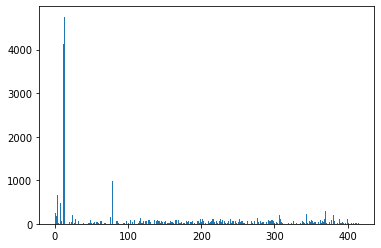

Feature 109: 94.451951


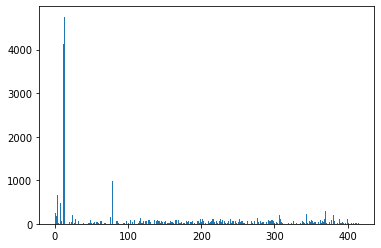

Feature 110: 3.064525


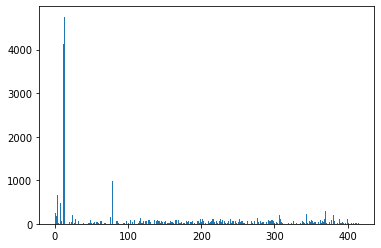

Feature 111: 34.182487


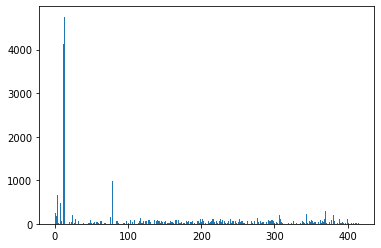

Feature 112: 40.857696


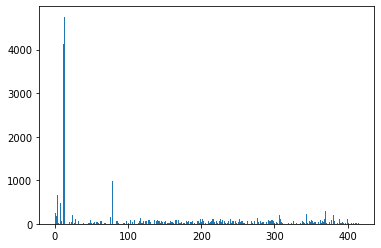

Feature 113: 1.584223


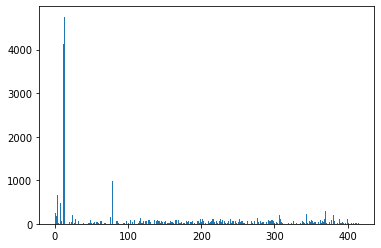

Feature 114: 26.138956


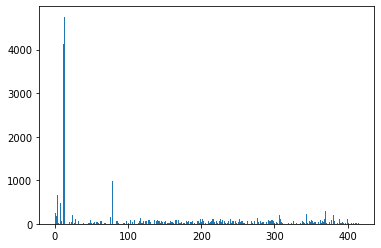

Feature 115: 5.197342


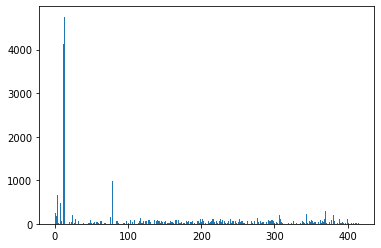

Feature 116: 63.473479


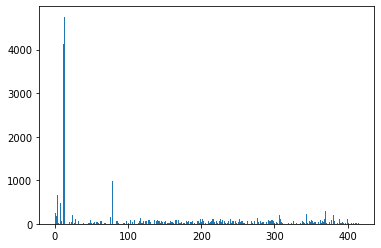

Feature 117: 136.720209


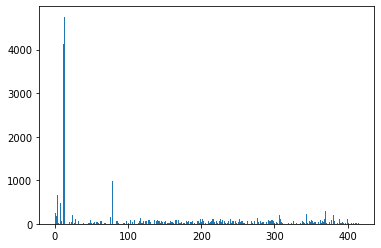

Feature 118: 12.002978


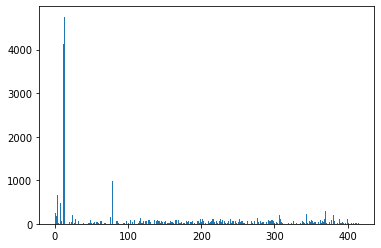

Feature 119: 38.102581


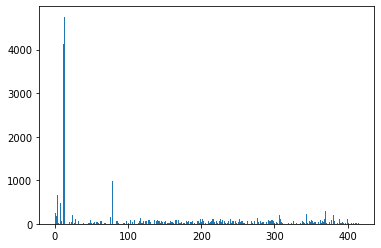

Feature 120: 26.988169


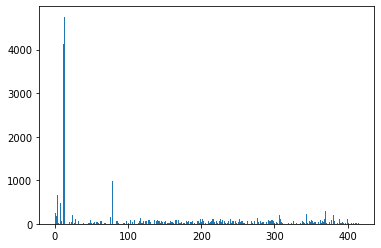

Feature 121: 64.892497


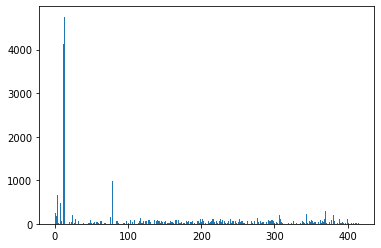

Feature 122: 78.904093


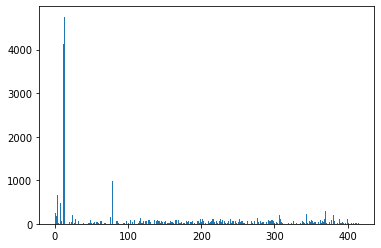

Feature 123: 36.971147


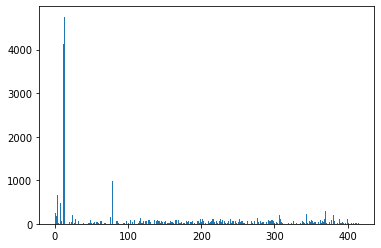

Feature 124: 65.673107


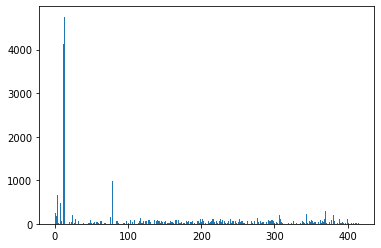

Feature 125: 70.668603


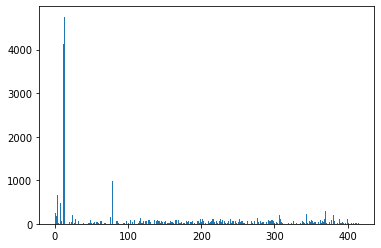

Feature 126: 86.964831


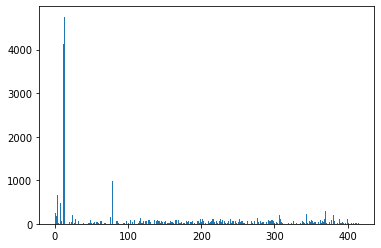

Feature 127: 1.480401


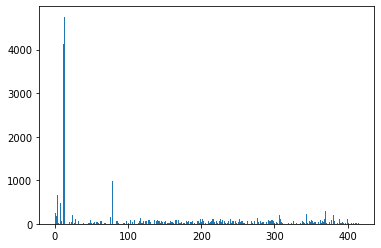

Feature 128: 93.053475


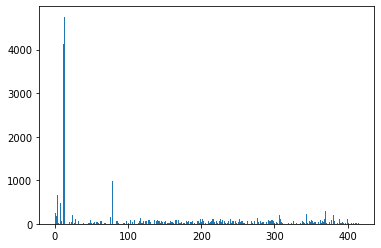

Feature 129: 76.387488


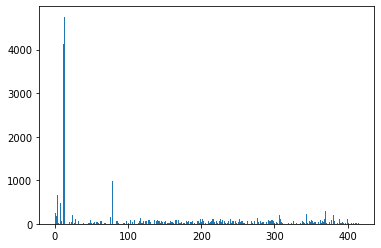

Feature 130: 52.293824


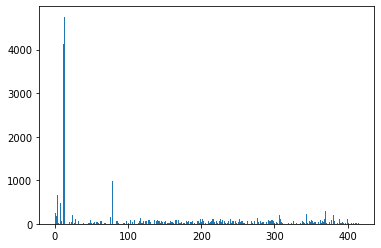

Feature 131: 47.133671


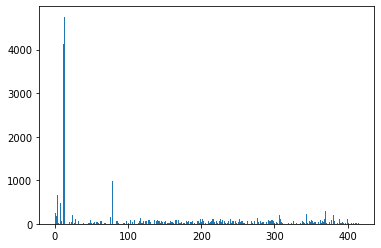

Feature 132: 0.906052


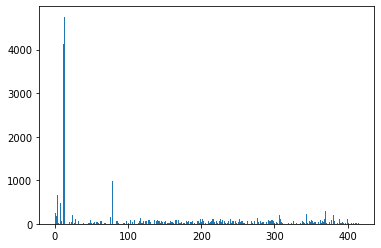

Feature 133: 57.312557


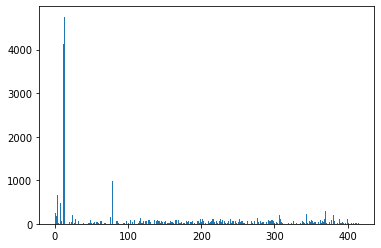

Feature 134: 77.889524


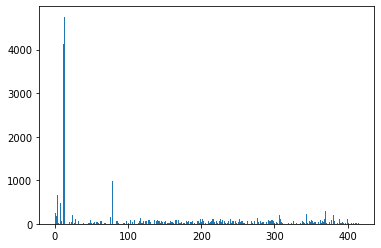

Feature 135: 3.690831


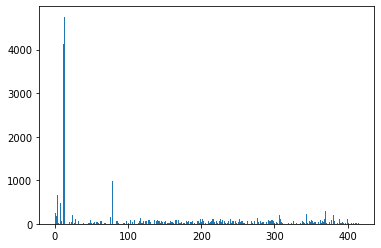

Feature 136: 82.085581


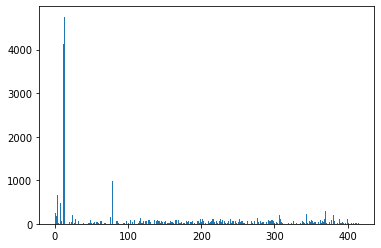

Feature 137: 74.305545


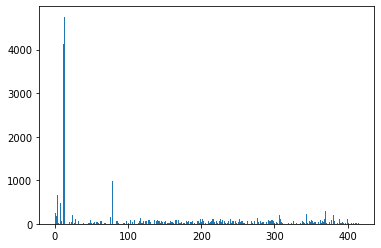

Feature 138: 55.822739


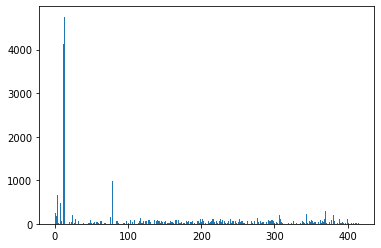

Feature 139: 60.065323


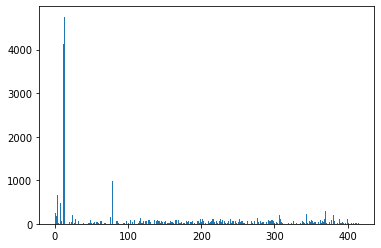

Feature 140: 82.603016


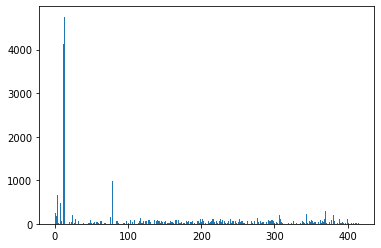

Feature 141: 82.314767


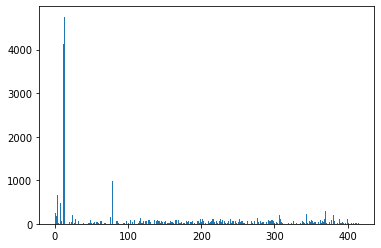

Feature 142: 59.674122


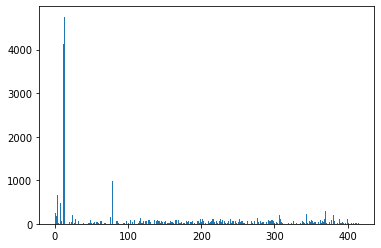

Feature 143: 67.402819


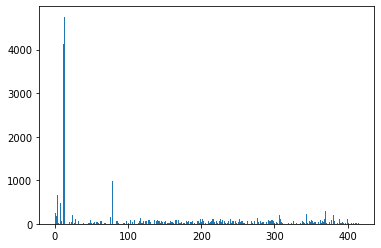

Feature 144: 10.715439


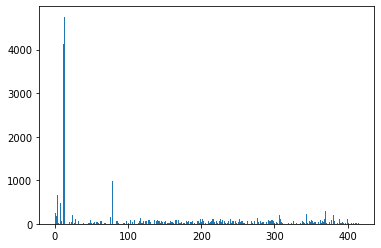

Feature 145: 91.536902


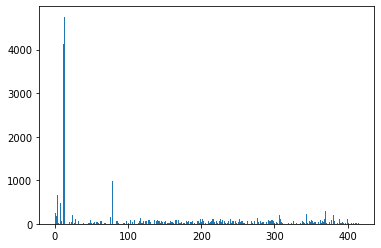

Feature 146: 69.329555


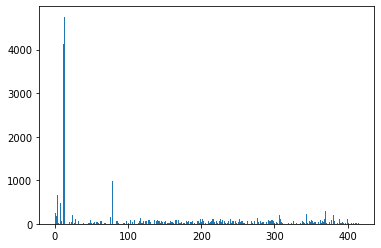

Feature 147: 37.236196


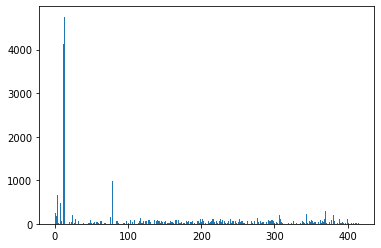

Feature 148: 65.389307


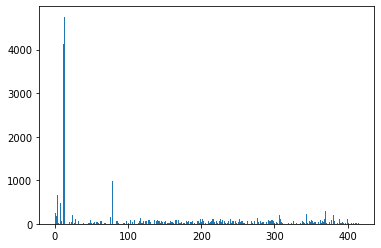

Feature 149: 32.860676


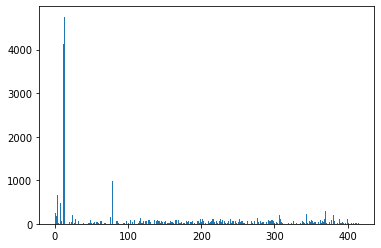

Feature 150: 31.529469


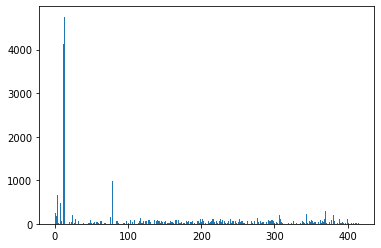

Feature 151: 56.987321


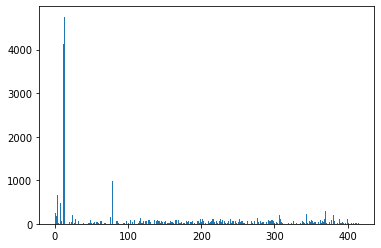

Feature 152: 27.671429


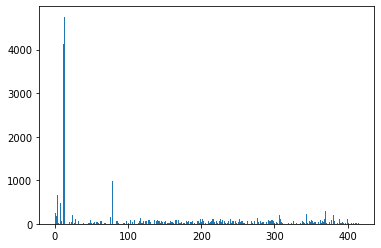

Feature 153: 4.036485


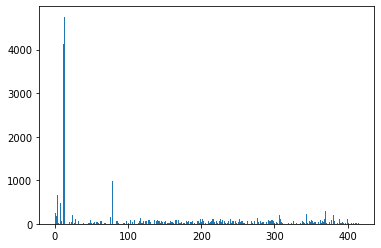

Feature 154: 15.036424


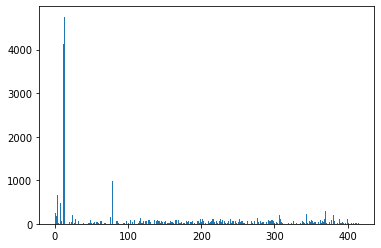

Feature 155: 11.156901


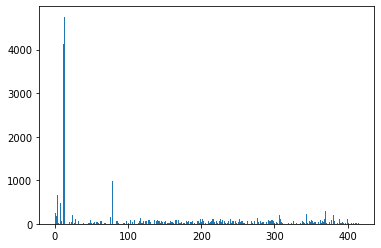

Feature 156: 79.997152


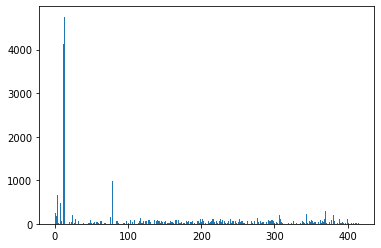

Feature 157: 13.710631


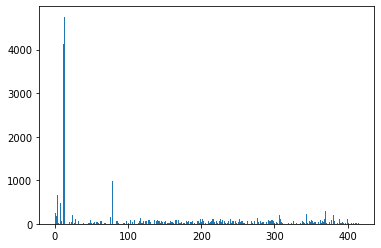

Feature 158: 54.849951


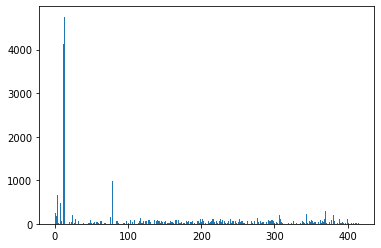

Feature 159: 50.029596


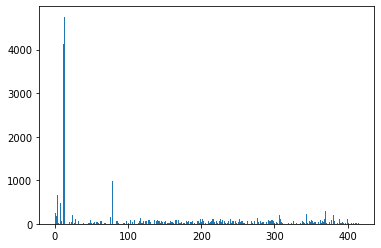

Feature 160: 0.931547


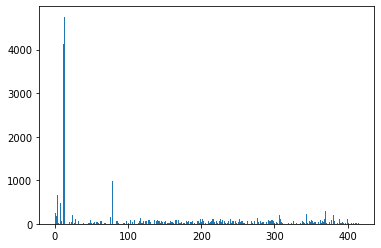

Feature 161: 50.070124


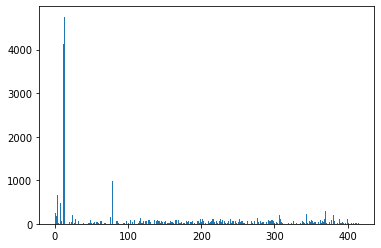

Feature 162: 21.886200


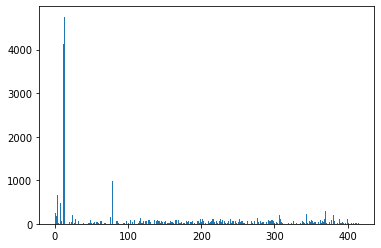

Feature 163: 87.084078


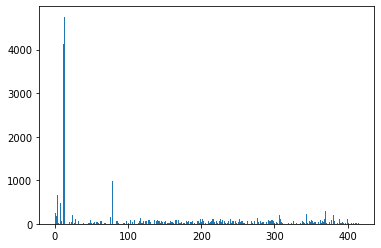

Feature 164: 81.892395


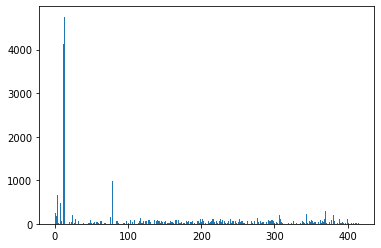

Feature 165: 78.212810


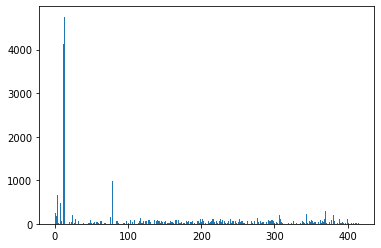

Feature 166: 81.819119


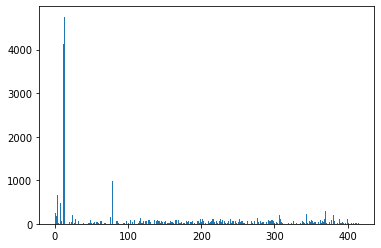

Feature 167: 18.839549


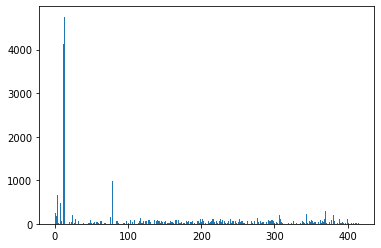

Feature 168: 3.980460


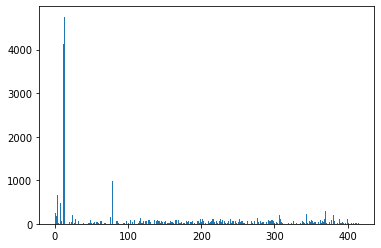

Feature 169: 76.058942


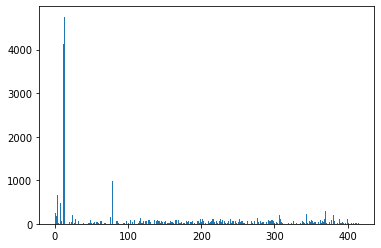

Feature 170: 8.358648


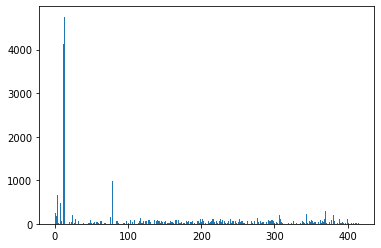

Feature 171: 84.282973


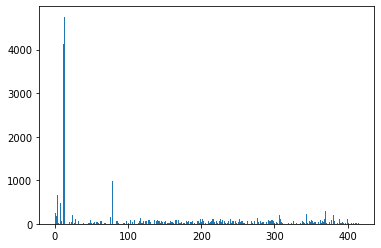

Feature 172: 9.101600


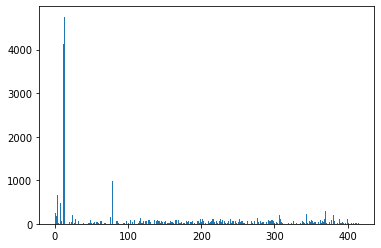

Feature 173: 32.408606


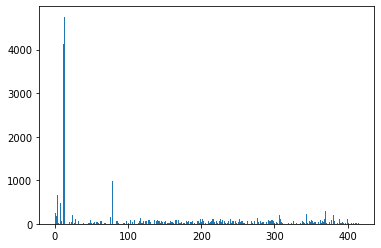

Feature 174: 42.049456


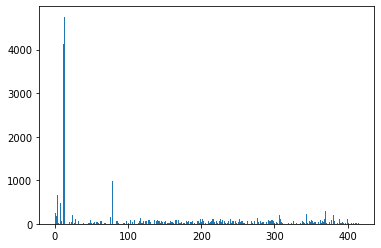

Feature 175: 84.375899


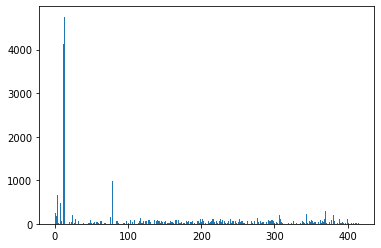

Feature 176: 29.605105


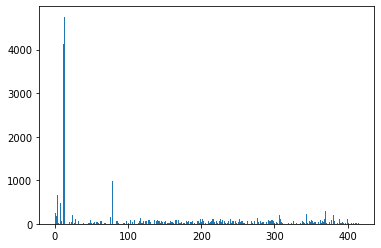

Feature 177: 19.519282


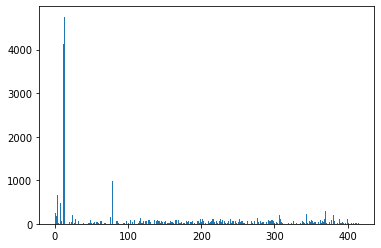

Feature 178: 95.361552


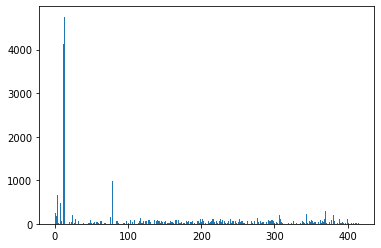

Feature 179: 78.334273


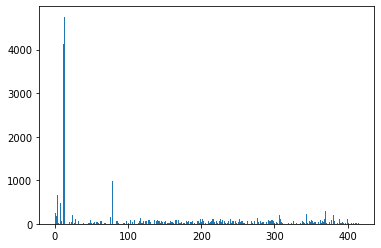

Feature 180: 55.749177


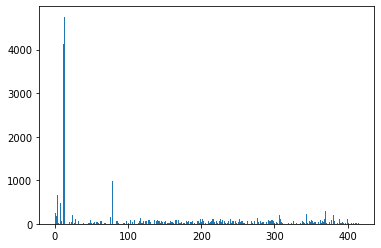

Feature 181: 36.497757


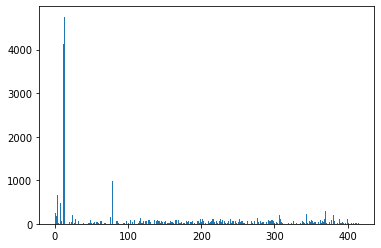

Feature 182: 2.361010


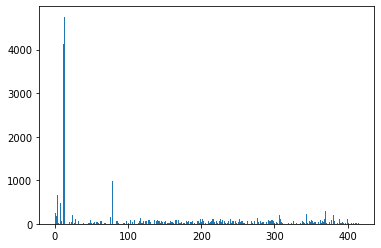

Feature 183: 53.048142


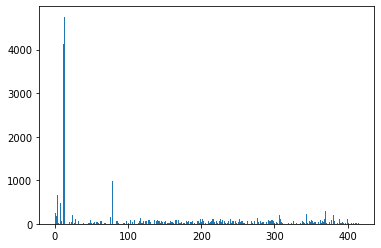

Feature 184: 3.739190


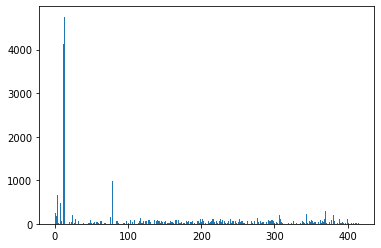

Feature 185: 50.075154


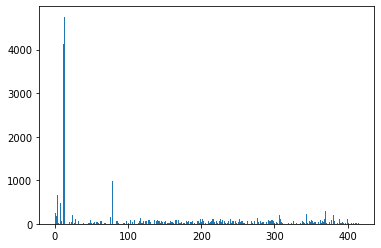

Feature 186: 39.270321


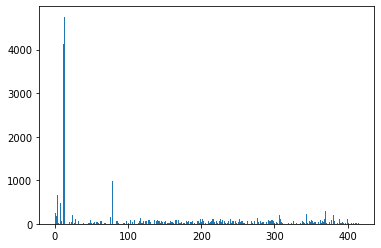

Feature 187: 43.082472


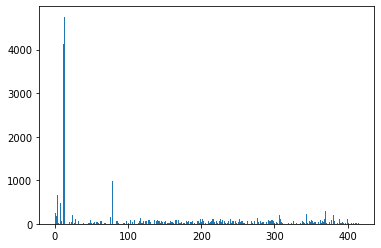

Feature 188: 65.278980


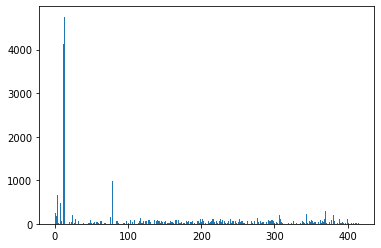

Feature 189: 149.812992


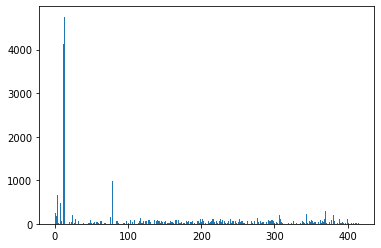

Feature 190: 68.319117


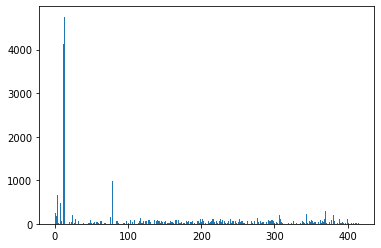

Feature 191: 25.567288


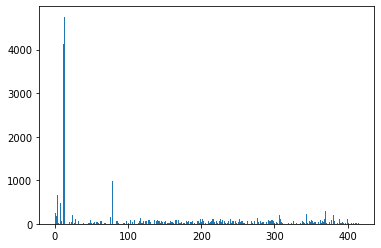

Feature 192: 0.337245


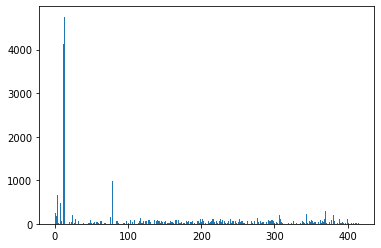

Feature 193: 75.468500


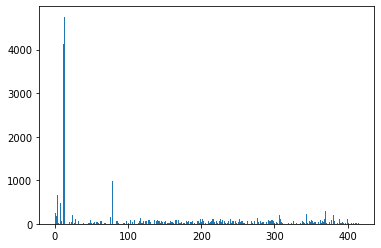

Feature 194: 36.231197


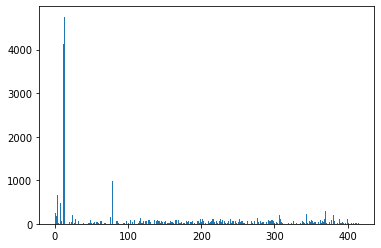

Feature 195: 70.463844


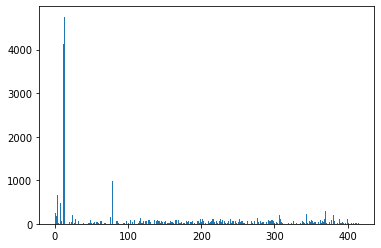

Feature 196: 61.221126


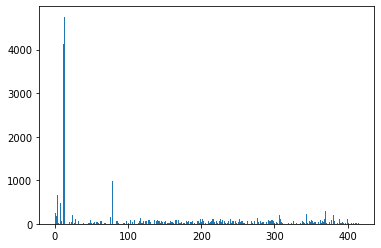

Feature 197: 93.861821


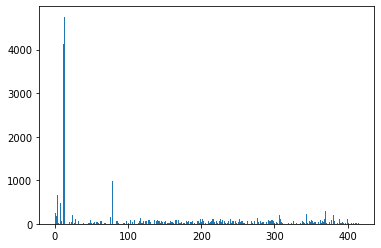

Feature 198: 23.734433


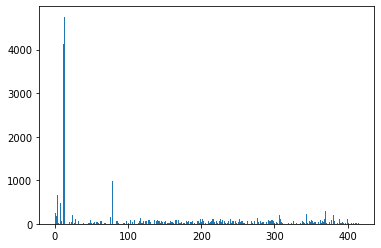

Feature 199: 106.394938


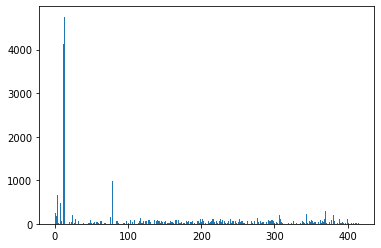

Feature 200: 33.057718


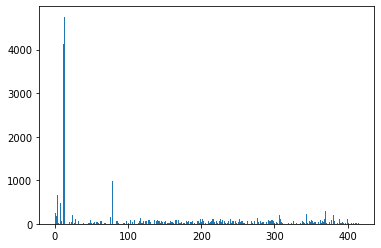

Feature 201: 0.376787


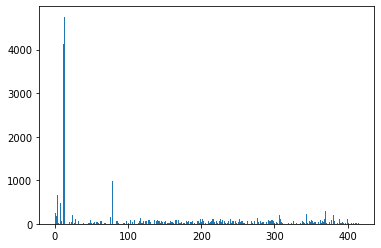

Feature 202: 104.268984


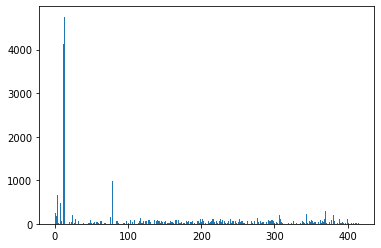

Feature 203: 74.440818


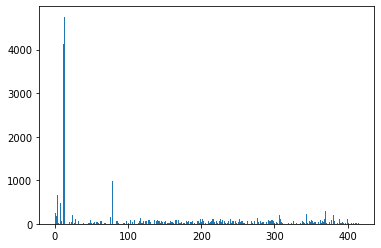

Feature 204: 46.946270


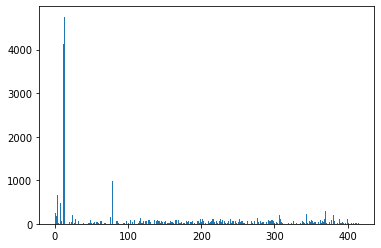

Feature 205: 52.123369


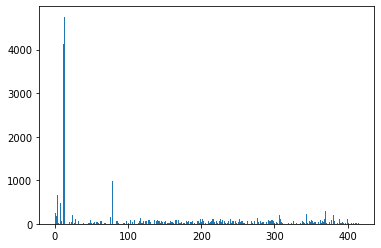

Feature 206: 8.496011


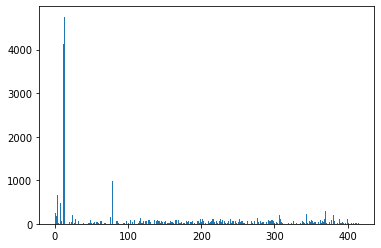

Feature 207: 0.000148


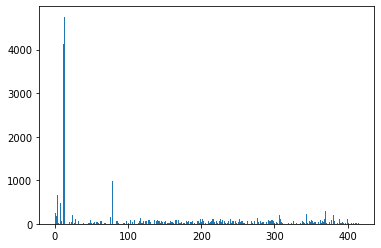

Feature 208: 67.900593


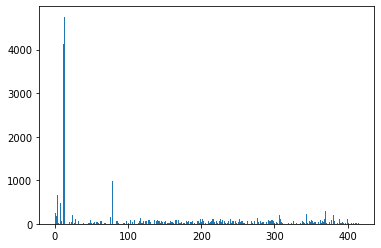

Feature 209: 43.995732


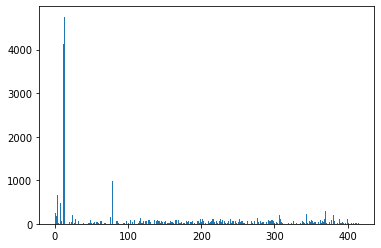

Feature 210: 58.952021


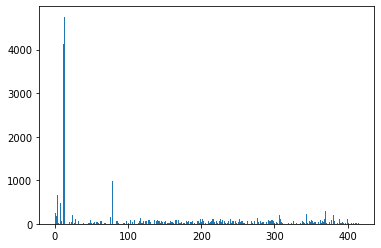

Feature 211: 18.834016


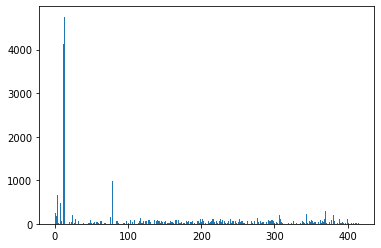

Feature 212: 56.207507


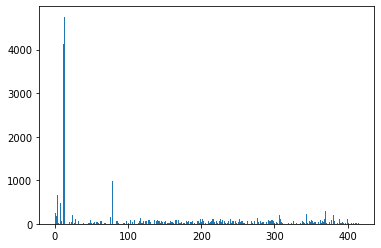

Feature 213: 48.714844


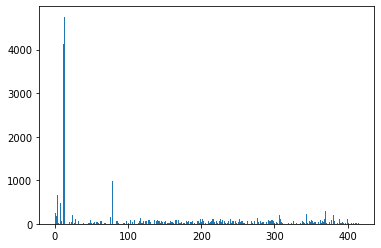

Feature 214: 65.392021


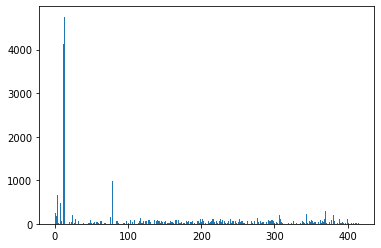

Feature 215: 101.390904


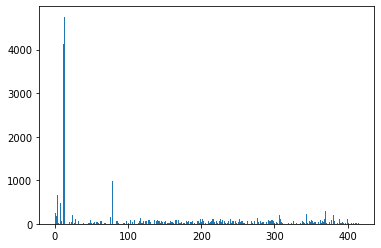

Feature 216: 57.165027


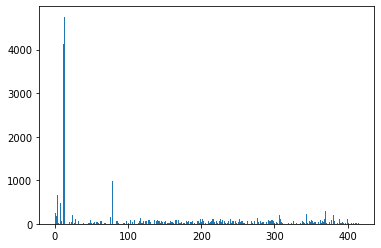

Feature 217: 109.485747


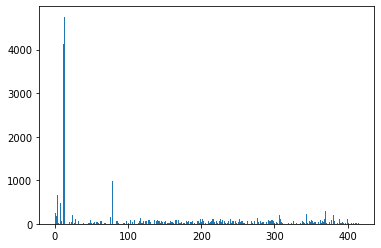

Feature 218: 49.764666


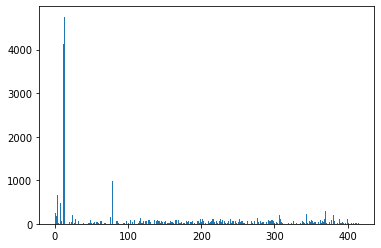

Feature 219: 45.489013


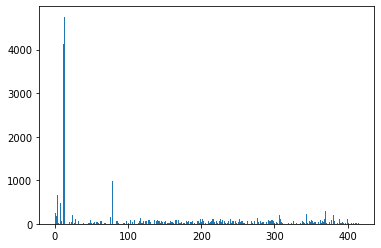

Feature 220: 54.433843


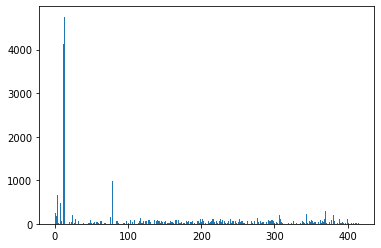

Feature 221: 58.692555


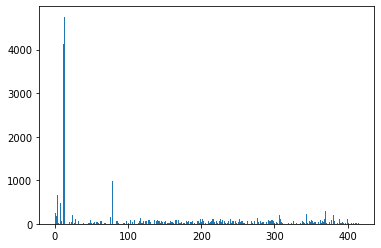

Feature 222: 21.964468


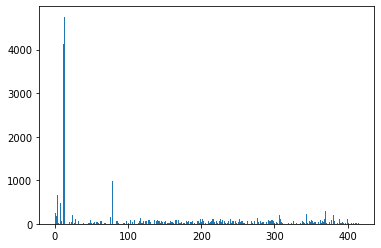

Feature 223: 57.984238


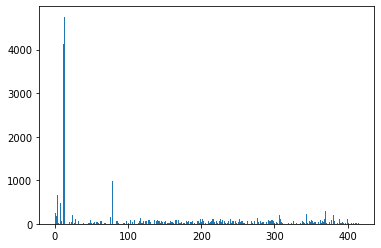

Feature 224: 58.607115


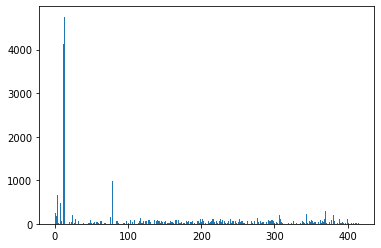

Feature 225: 57.369011


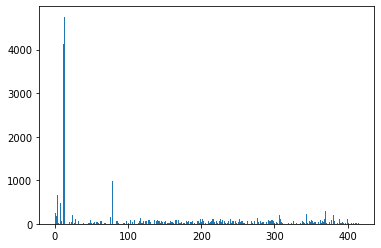

Feature 226: 100.886492


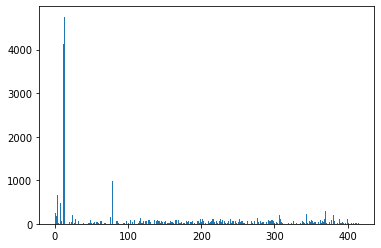

Feature 227: 59.128523


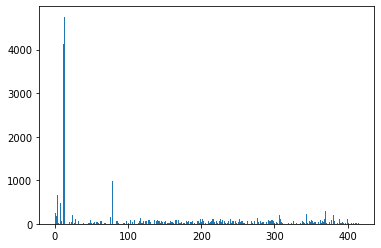

Feature 228: 51.981295


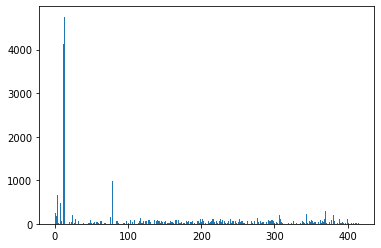

Feature 229: 86.470352


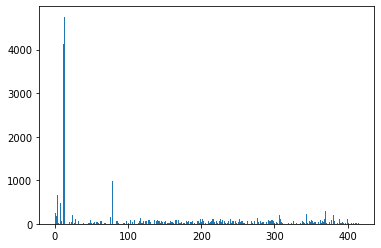

Feature 230: 56.788541


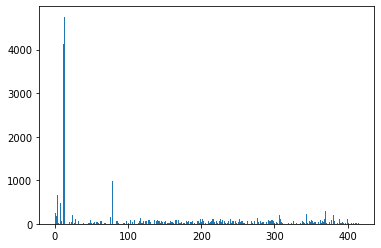

Feature 231: 59.862912


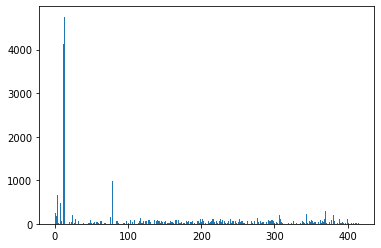

Feature 232: 67.449696


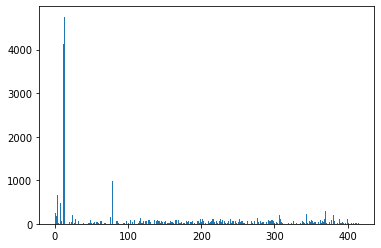

Feature 233: 7.389974


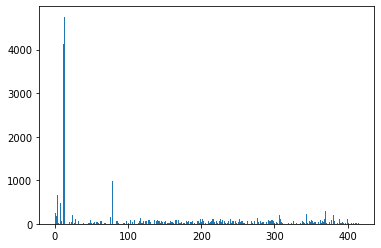

Feature 234: 118.020032


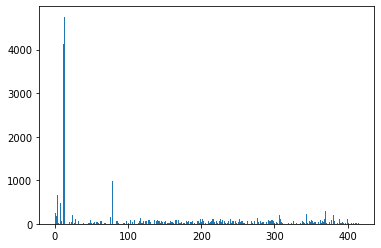

Feature 235: 40.043348


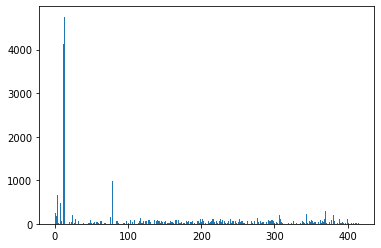

Feature 236: 11.175909


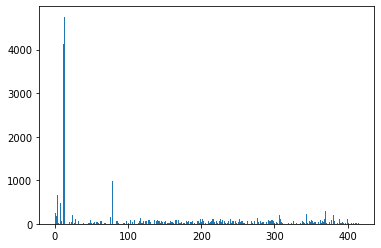

Feature 237: 55.412734


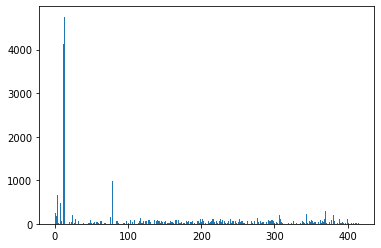

Feature 238: 45.530475


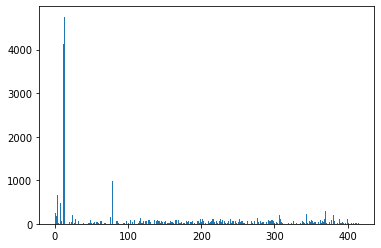

Feature 239: 2.303702


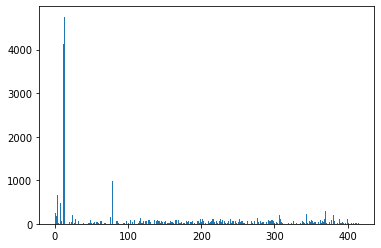

Feature 240: 100.168716


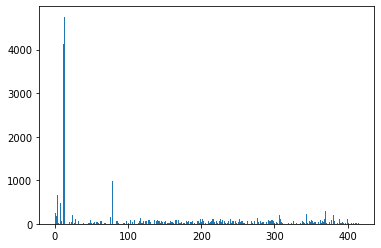

Feature 241: 11.958536


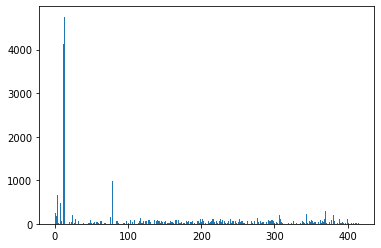

Feature 242: 34.455841


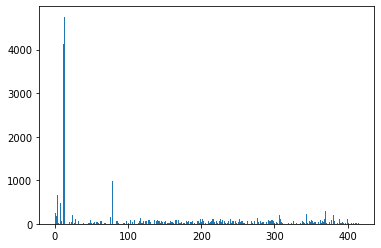

Feature 243: 61.394256


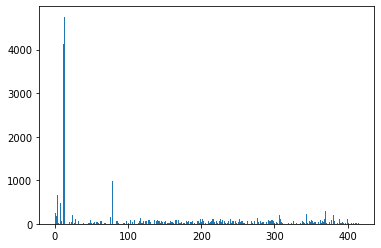

Feature 244: 53.229723


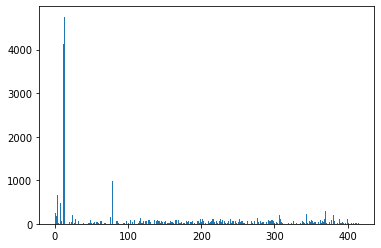

Feature 245: 52.926219


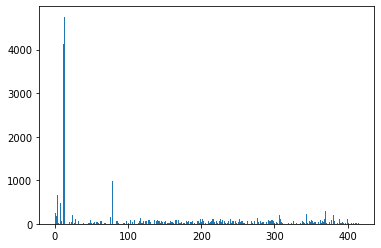

Feature 246: 56.240621


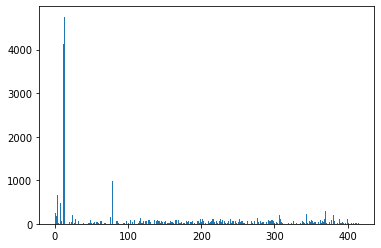

Feature 247: 58.094640


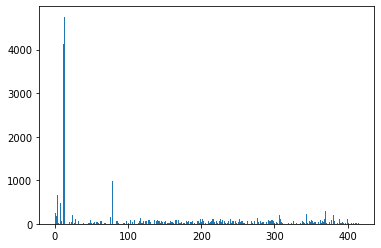

Feature 248: 28.409751


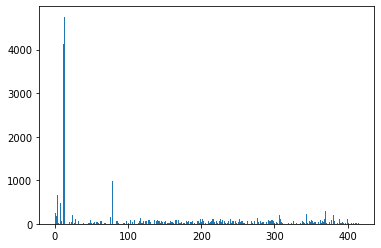

Feature 249: 55.173932


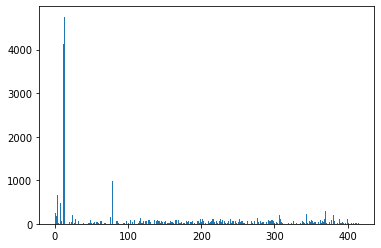

Feature 250: 48.451368


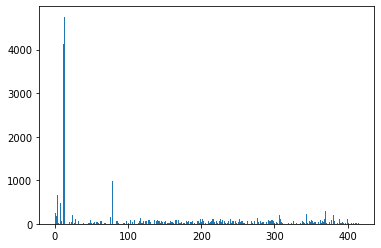

Feature 251: 48.724843


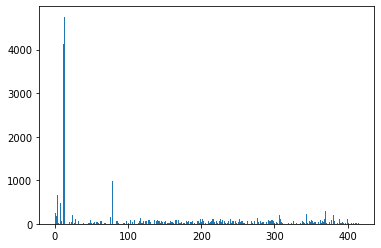

Feature 252: 118.587345


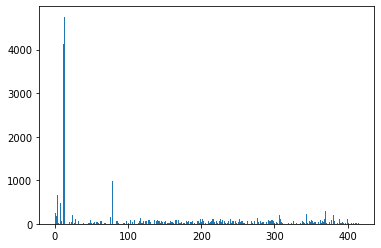

Feature 253: 45.164722


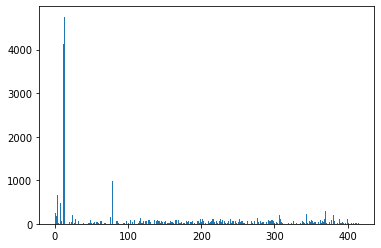

Feature 254: 35.597071


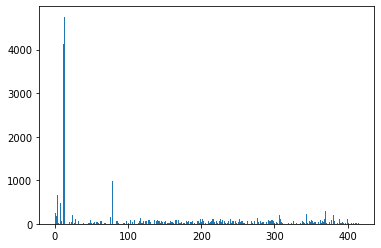

Feature 255: 61.295070


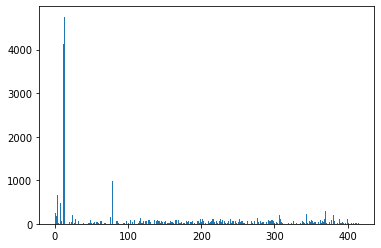

Feature 256: 57.934852


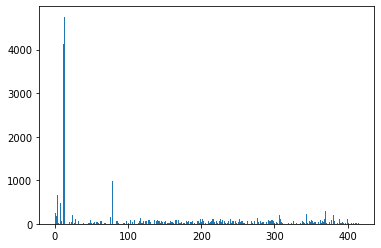

Feature 257: 68.502090


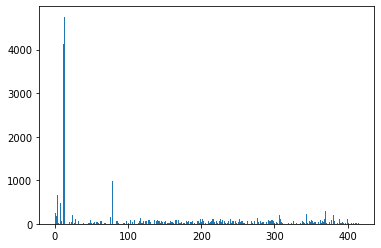

Feature 258: 26.045116


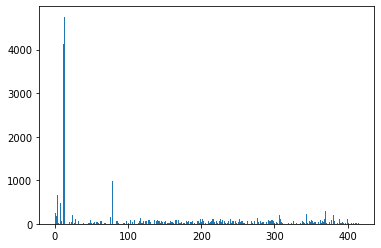

Feature 259: 27.670932


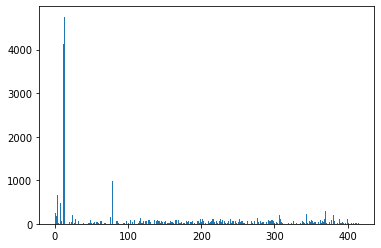

Feature 260: 35.032690


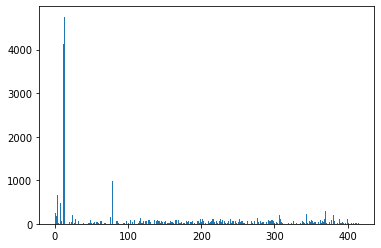

Feature 261: 55.694581


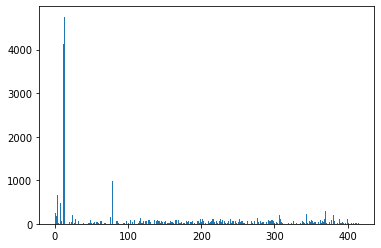

Feature 262: 0.362629


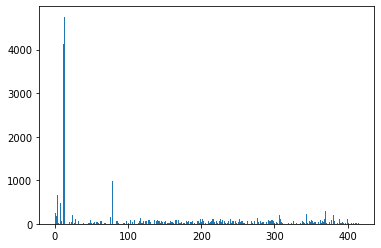

Feature 263: 59.694327


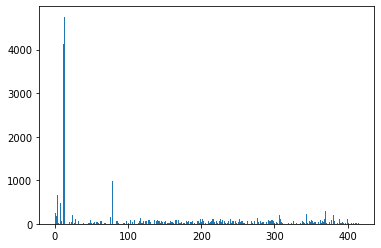

Feature 264: 67.511148


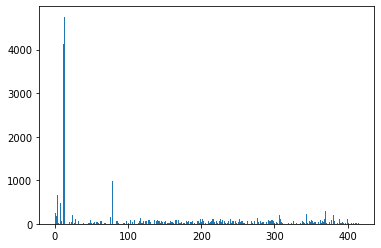

Feature 265: 46.865530


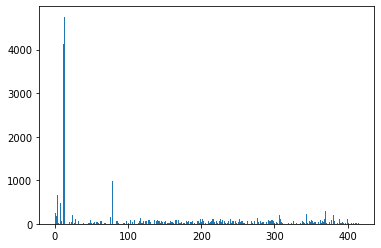

Feature 266: 0.656181


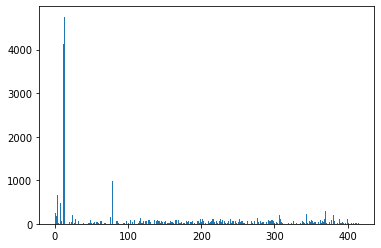

Feature 267: 2.497594


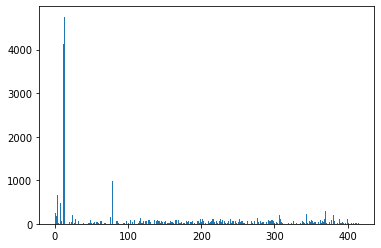

Feature 268: 60.579722


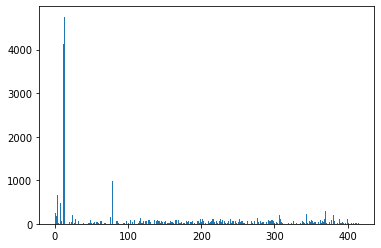

Feature 269: 57.111539


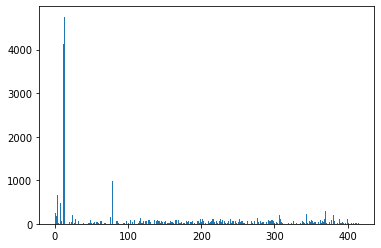

Feature 270: 16.859396


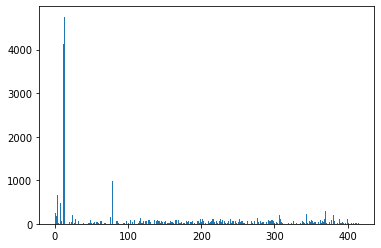

Feature 271: 43.852772


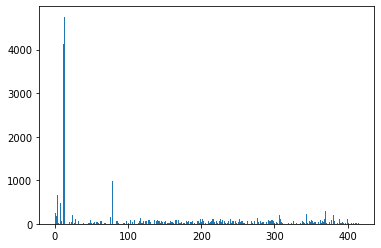

Feature 272: 35.301782


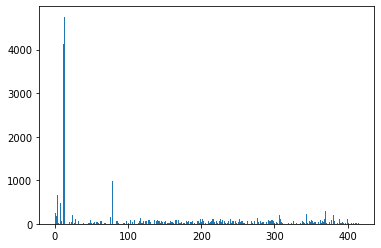

Feature 273: 73.042529


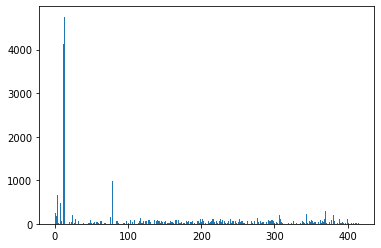

Feature 274: 0.052136


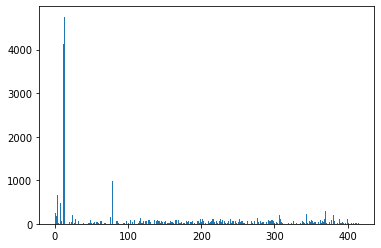

Feature 275: 17.417115


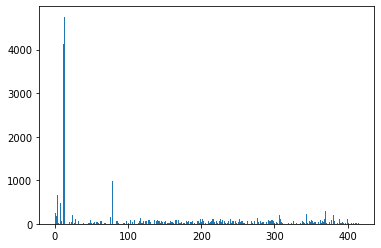

Feature 276: 190.439793


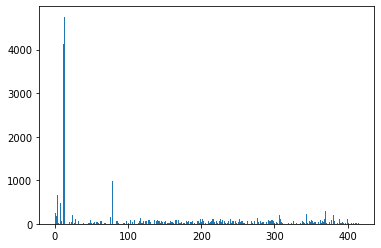

Feature 277: 128.031383


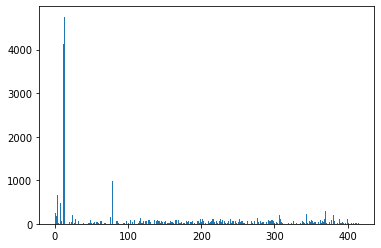

Feature 278: 32.204796


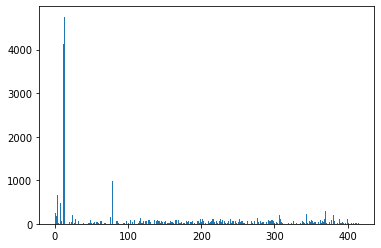

Feature 279: 39.314592


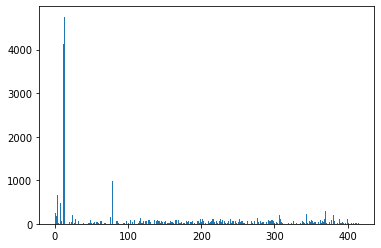

Feature 280: 4.809157


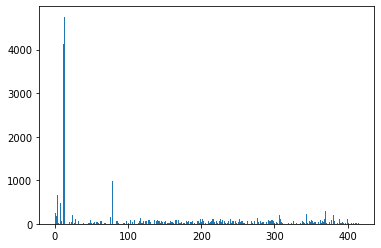

Feature 281: 65.765422


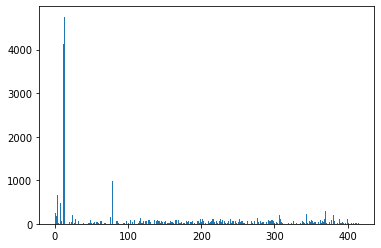

Feature 282: 24.555462


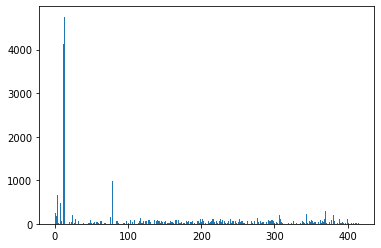

Feature 283: 13.892845


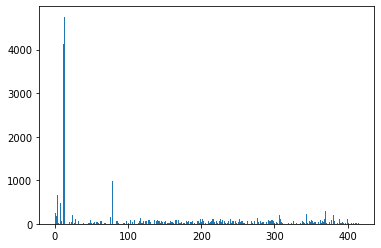

Feature 284: 44.379110


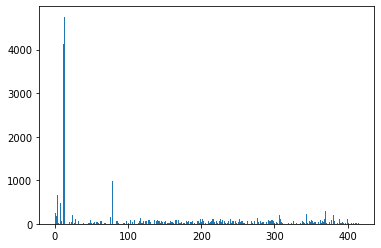

Feature 285: 30.753502


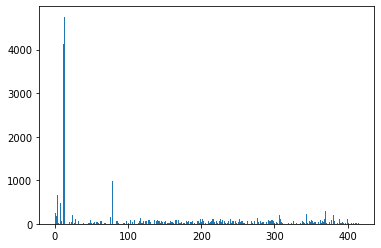

Feature 286: 18.451975


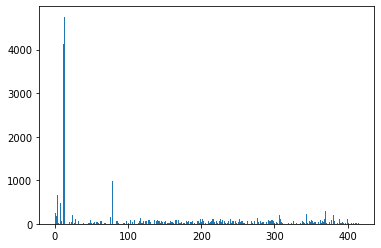

Feature 287: 0.399220


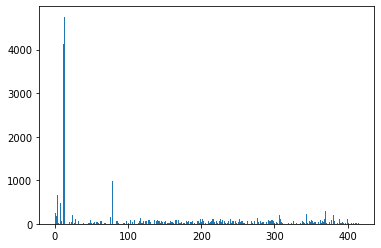

Feature 288: 4.584336


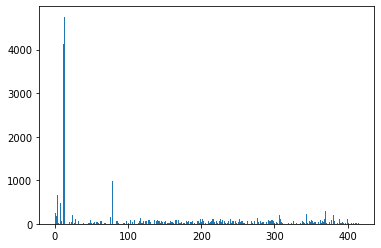

Feature 289: 31.395002


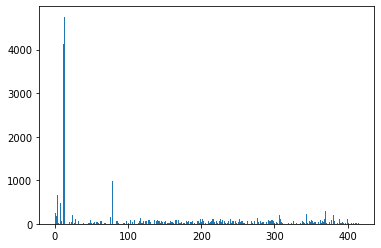

Feature 290: 8.750518


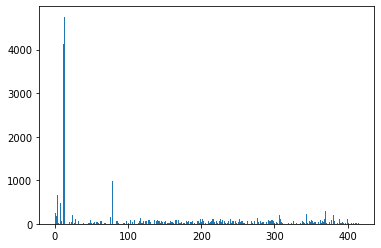

Feature 291: 59.013093


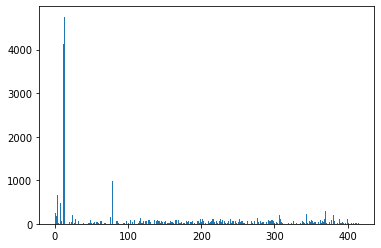

Feature 292: 87.140054


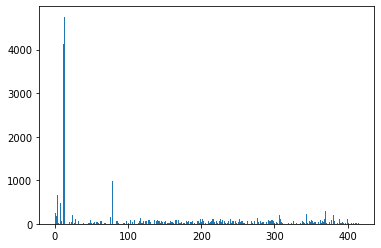

Feature 293: 68.042480


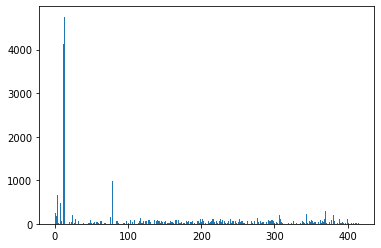

Feature 294: 148.582721


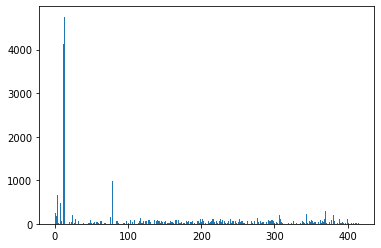

Feature 295: 55.888689


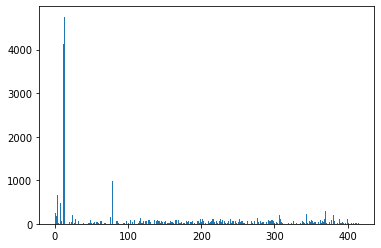

Feature 296: 92.328750


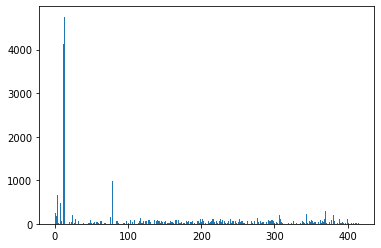

Feature 297: 90.542148


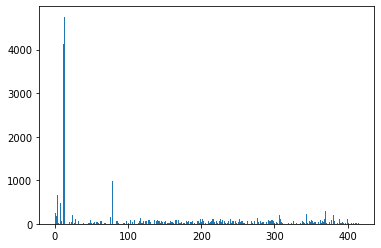

Feature 298: 95.391154


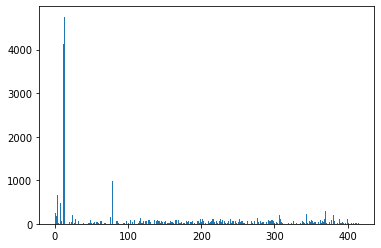

Feature 299: 56.508988


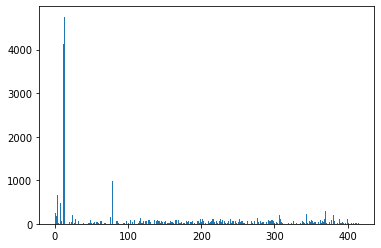

Feature 300: 8.046520


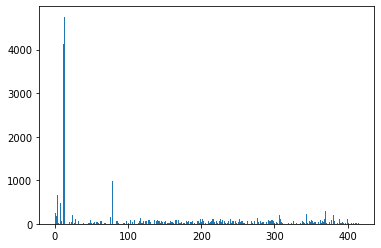

Feature 301: 79.428102


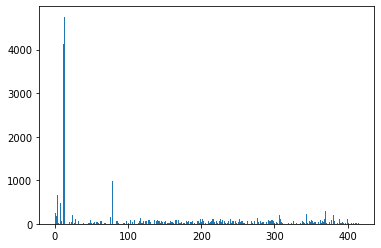

Feature 302: 44.615457


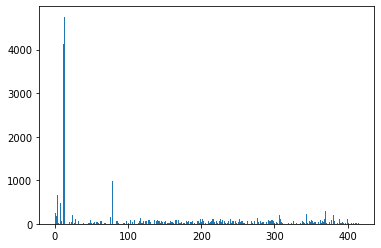

Feature 303: 35.536718


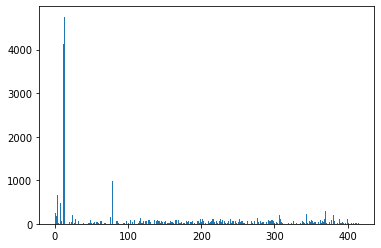

Feature 304: 9.656760


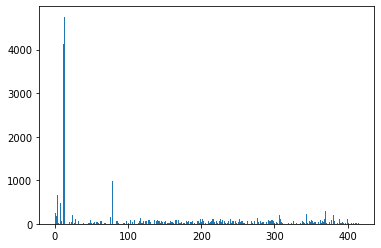

Feature 305: 73.867035


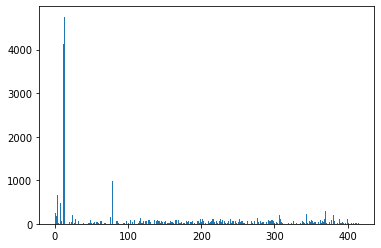

Feature 306: 130.341458


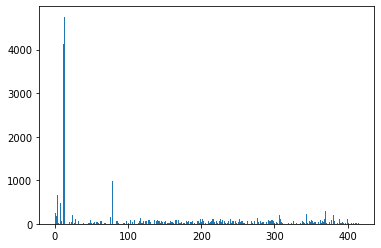

Feature 307: 190.921647


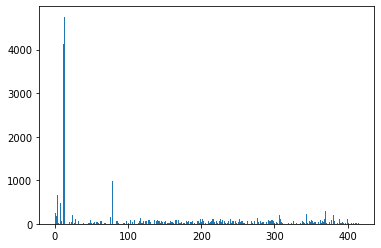

Feature 308: 119.973930


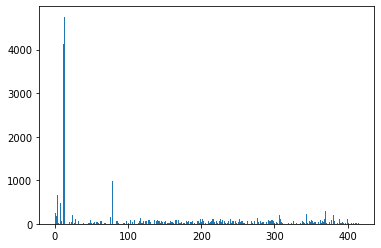

Feature 309: 20.907588


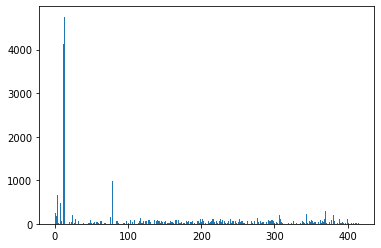

Feature 310: 34.387523


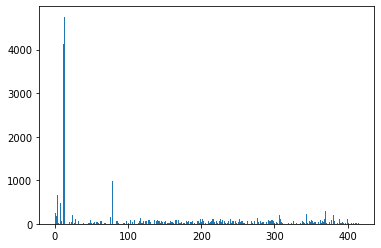

Feature 311: 25.035755


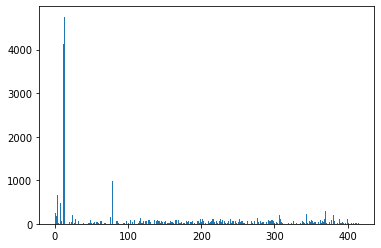

Feature 312: 1.530277


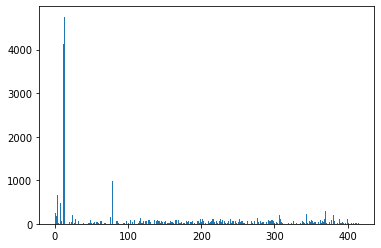

Feature 313: 19.616145


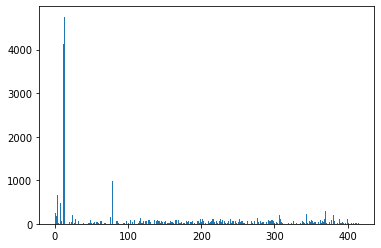

Feature 314: 4.358910


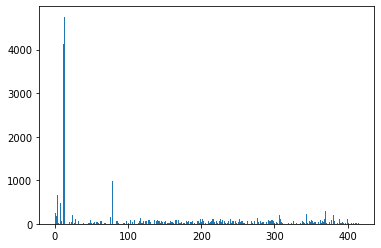

Feature 315: 0.638046


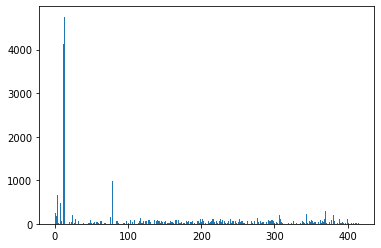

Feature 316: 0.448450


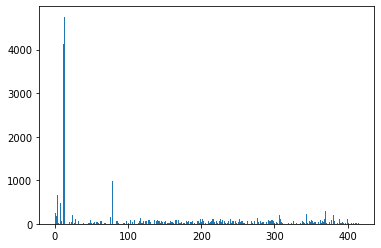

Feature 317: 18.732522


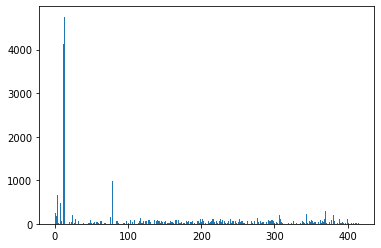

Feature 318: 4.961582


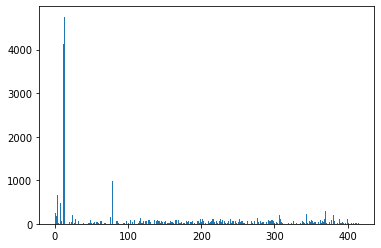

Feature 319: 7.352804


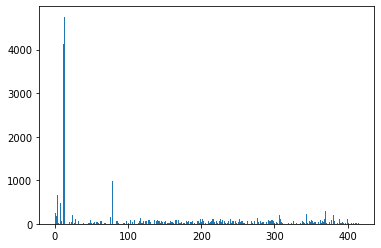

Feature 320: 4.067231


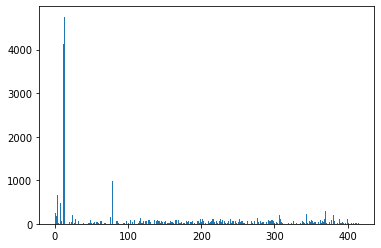

Feature 321: 1.399907


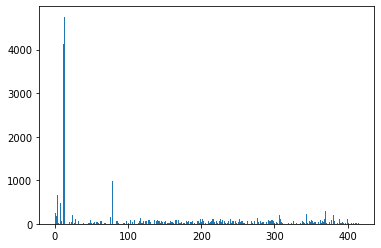

Feature 322: 2.583457


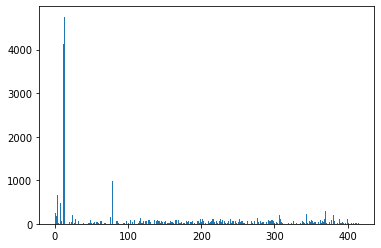

Feature 323: 23.664111


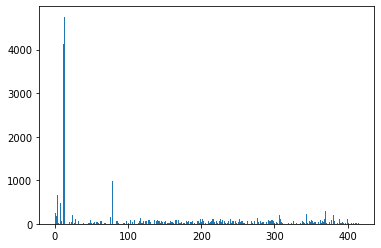

Feature 324: 10.513973


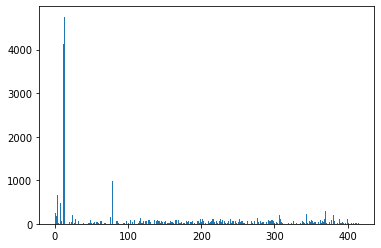

Feature 325: 0.714182


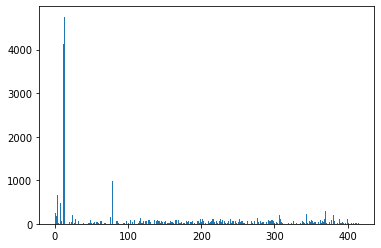

Feature 326: 58.605280


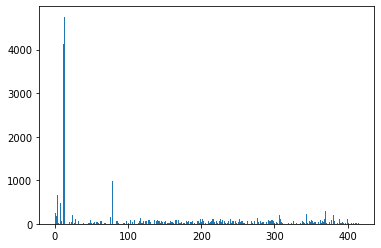

Feature 327: 19.339939


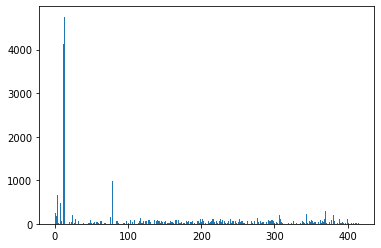

Feature 328: 3.156083


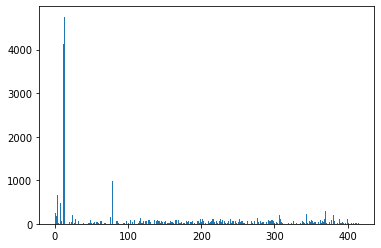

Feature 329: 0.055330


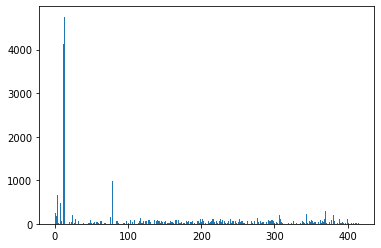

Feature 330: 26.060286


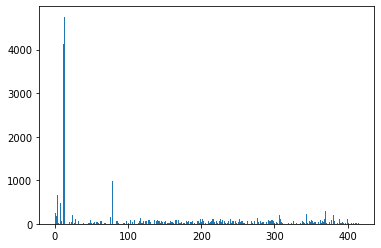

Feature 331: 3.651962


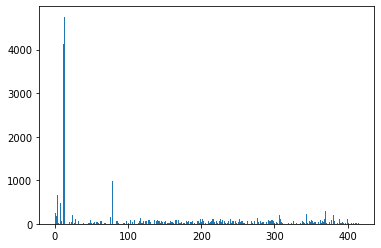

Feature 332: 31.405399


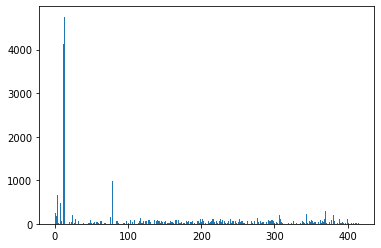

Feature 333: 2.850745


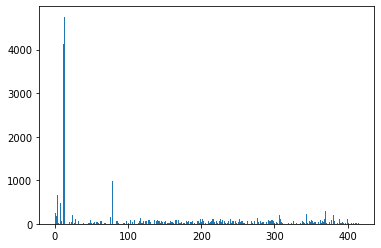

Feature 334: 6.806607


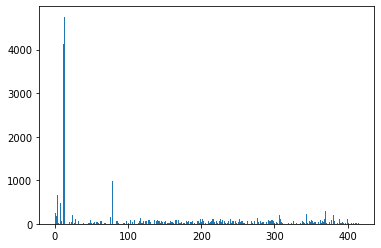

Feature 335: 0.884890


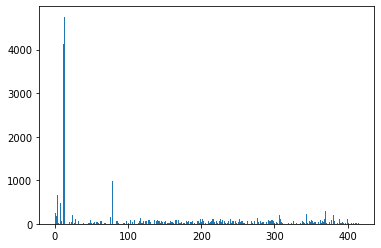

Feature 336: 28.614039


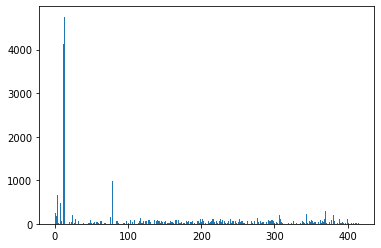

Feature 337: 3.778168


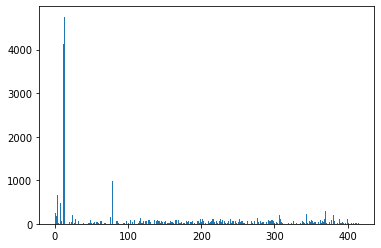

Feature 338: 53.573759


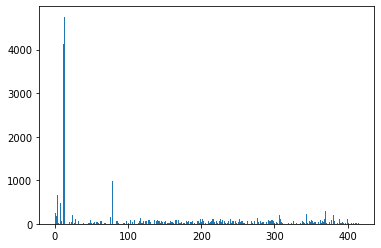

Feature 339: 21.039159


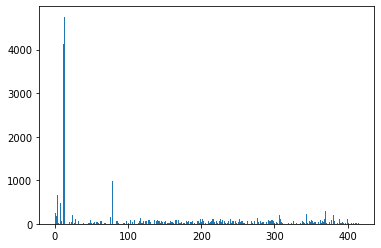

Feature 340: 48.843849


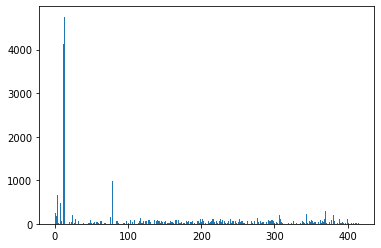

Feature 341: 26.348454


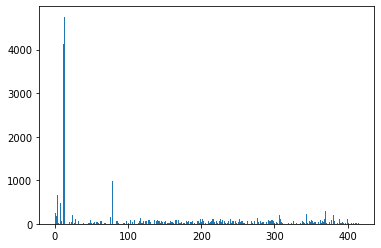

Feature 342: 99.655575


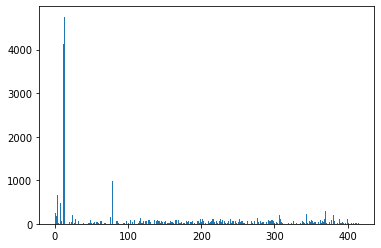

Feature 343: 80.611846


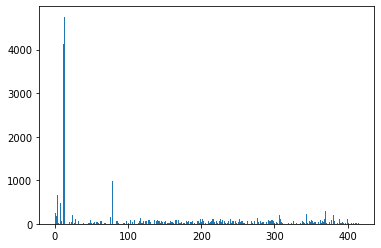

Feature 344: 225.966951


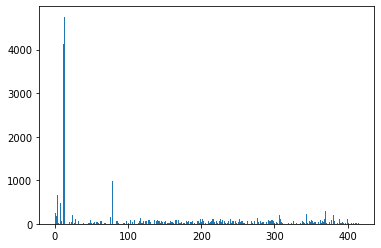

Feature 345: 22.742111


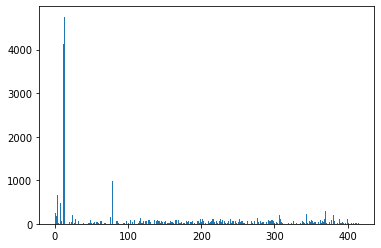

Feature 346: 58.708357


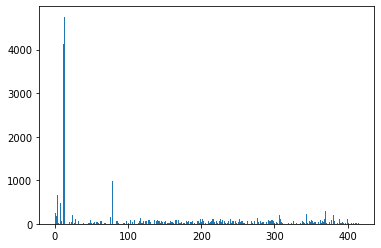

Feature 347: 55.725398


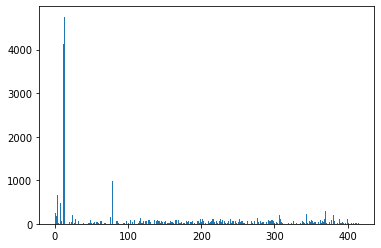

Feature 348: 71.824798


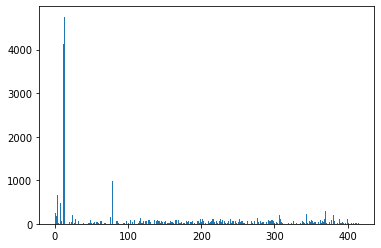

Feature 349: 43.157319


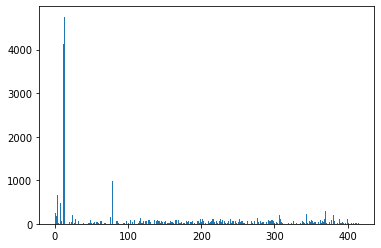

Feature 350: 40.154286


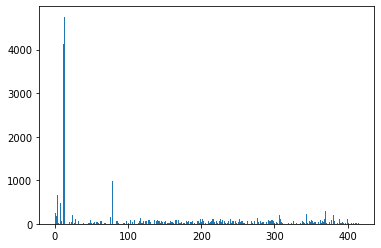

Feature 351: 92.833607


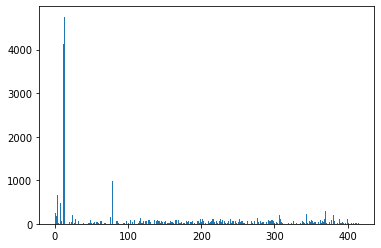

Feature 352: 58.350987


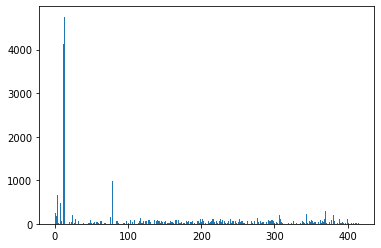

Feature 353: 25.386578


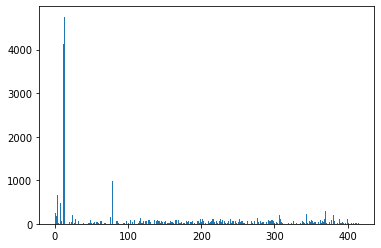

Feature 354: 66.005326


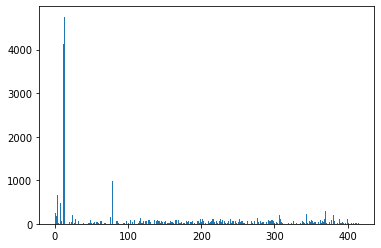

Feature 355: 31.774205


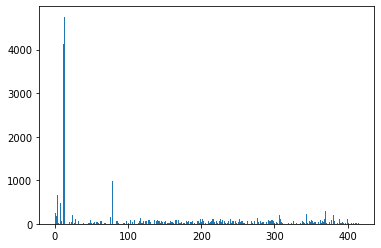

Feature 356: 44.158916


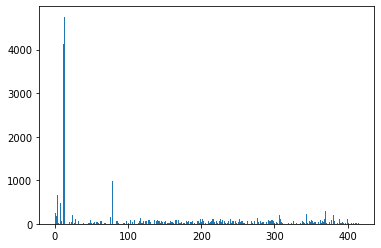

Feature 357: 96.831754


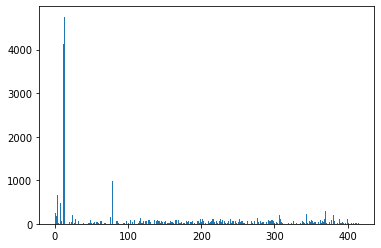

Feature 358: 74.320993


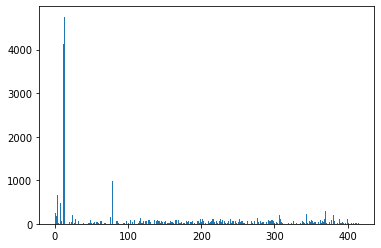

Feature 359: 4.183999


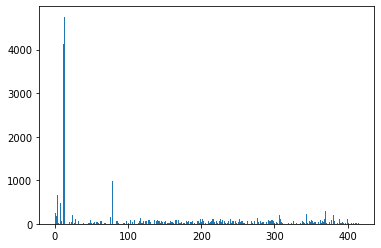

Feature 360: 41.576177


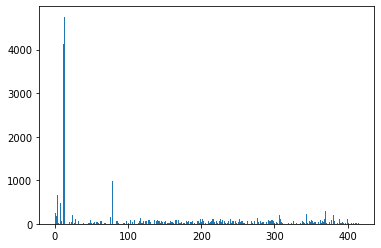

Feature 361: 24.224657


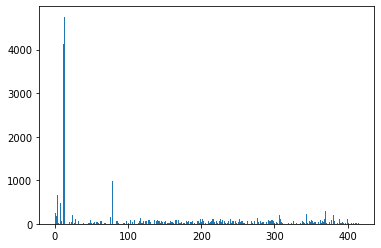

Feature 362: 64.576878


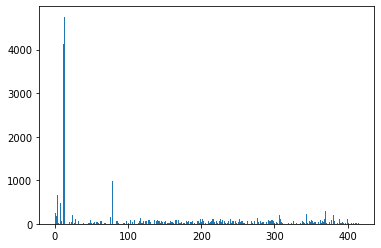

Feature 363: 95.229061


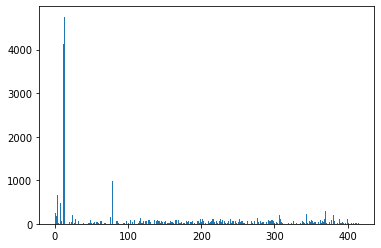

Feature 364: 8.919507


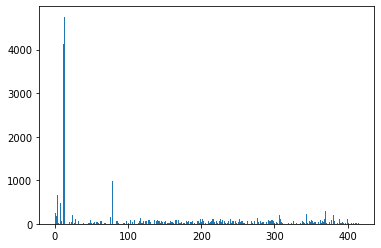

Feature 365: 56.848394


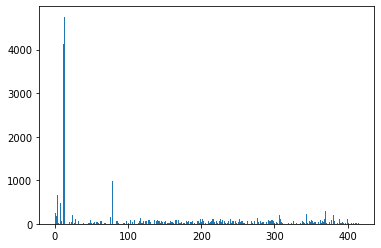

Feature 366: 57.256753


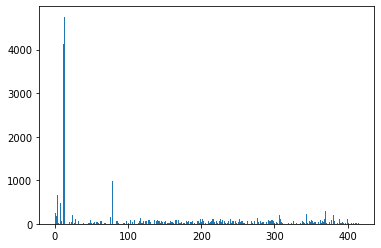

Feature 367: 38.308095


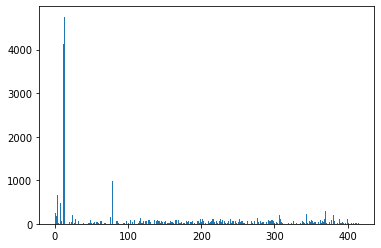

Feature 368: 99.709253


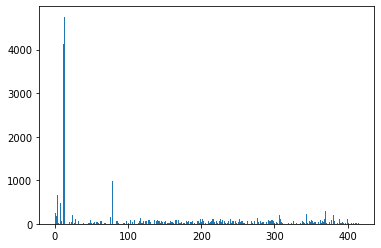

Feature 369: 42.618537


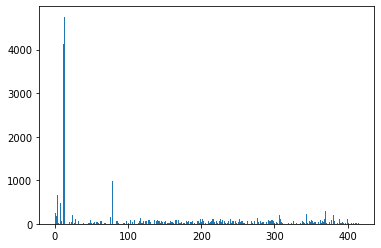

Feature 370: 294.867210


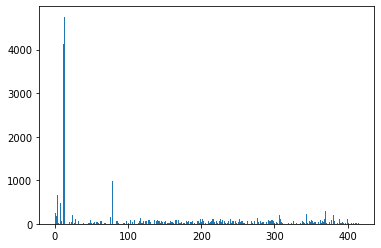

Feature 371: 18.872394


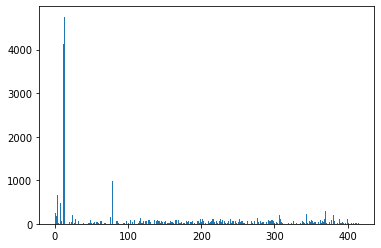

Feature 372: 20.777561


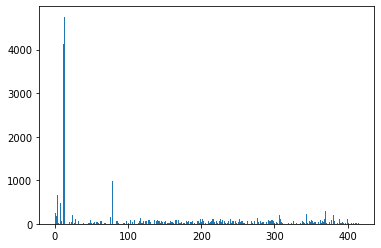

Feature 373: 18.479426


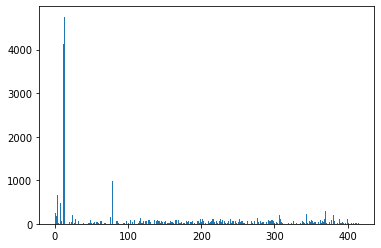

Feature 374: 2.142360


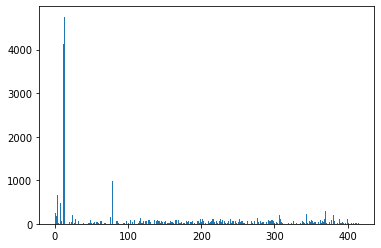

Feature 375: 33.997735


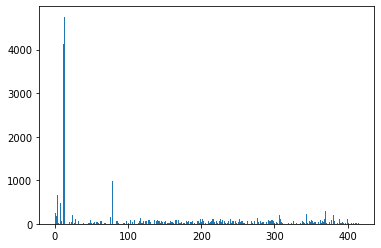

Feature 376: 6.200169


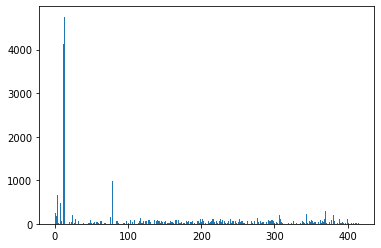

Feature 377: 200.679388


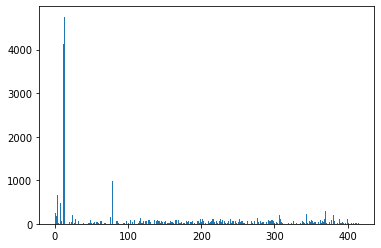

Feature 378: 91.908529


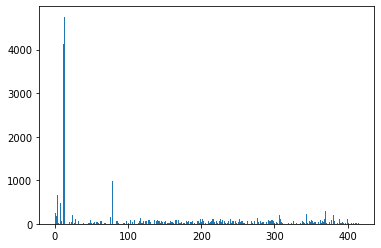

Feature 379: 0.018796


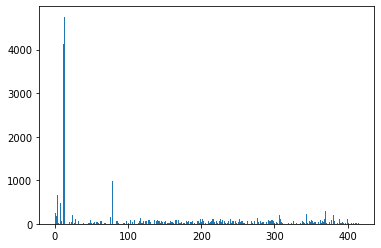

Feature 380: 2.406565


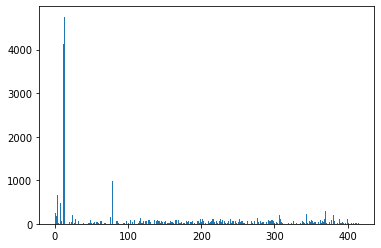

Feature 381: 190.597348


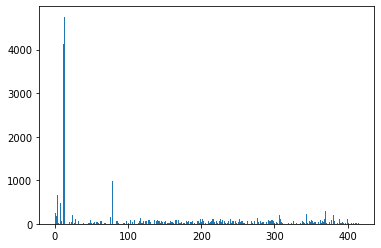

Feature 382: 72.856705


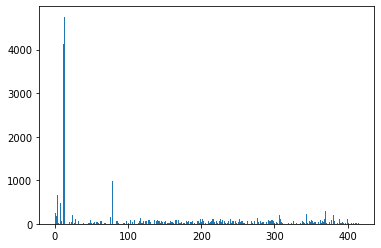

Feature 383: 23.017202


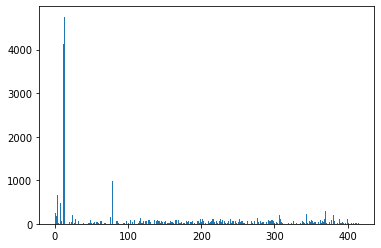

Feature 384: 3.839243


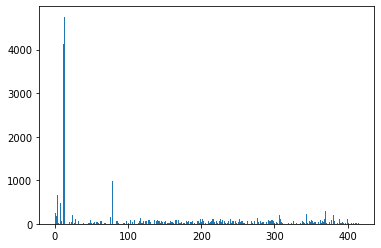

Feature 385: 0.819449


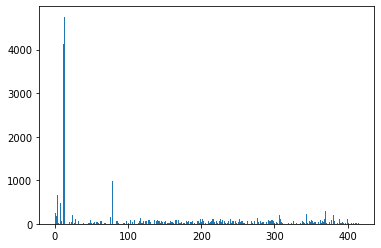

Feature 386: 8.358648


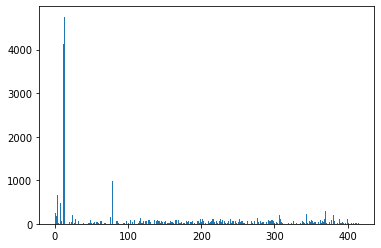

Feature 387: 46.823689


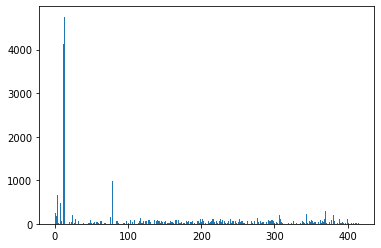

Feature 388: 285.097117


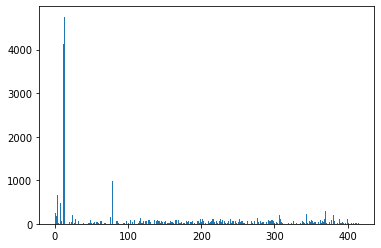

Feature 389: 100.168716


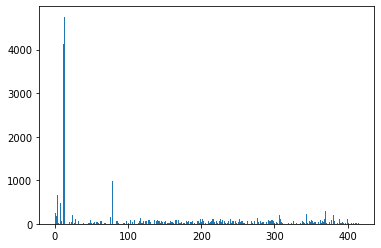

Feature 390: 11.674353


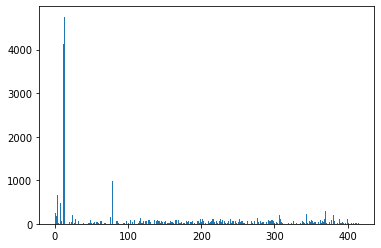

Feature 391: 11.958536


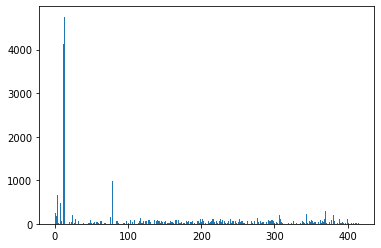

Feature 392: 26.870438


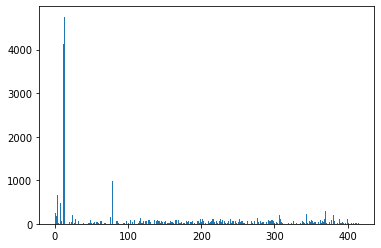

Feature 393: 29.928612


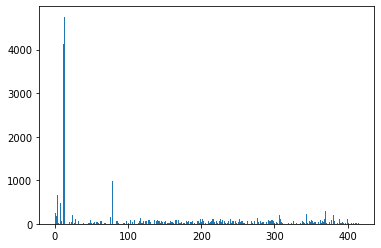

Feature 394: 18.236445


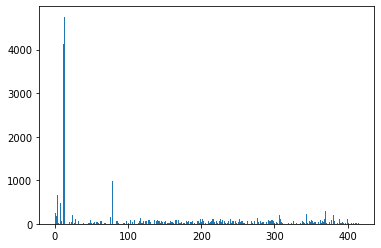

Feature 395: 0.089777


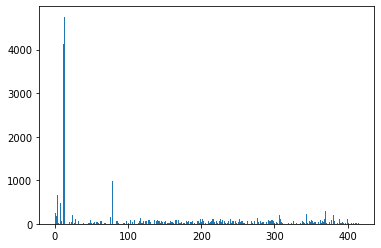

Feature 396: 0.566119


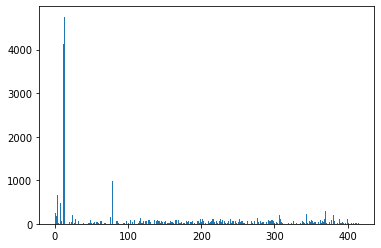

Feature 397: 23.218424


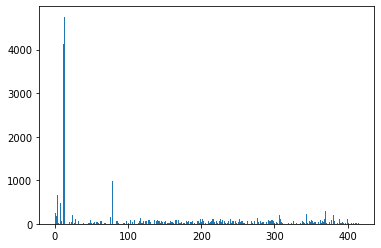

Feature 398: 12.764838


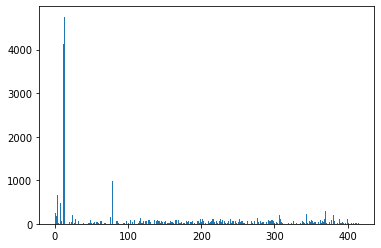

Feature 399: 1.208715


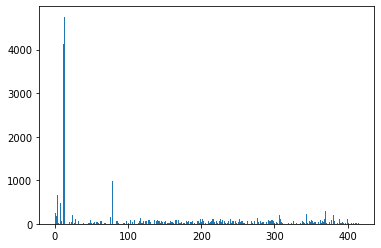

Feature 400: 113.330515


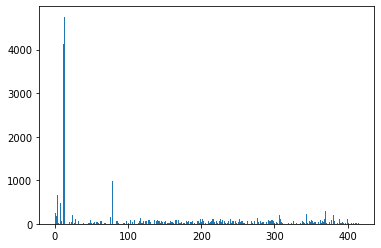

Feature 401: 28.050331


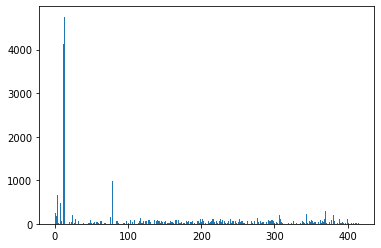

Feature 402: 196.147095


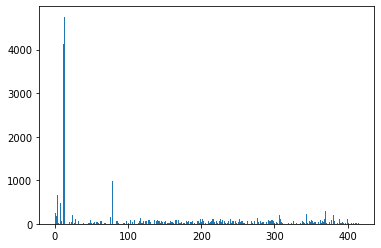

Feature 403: 76.322697


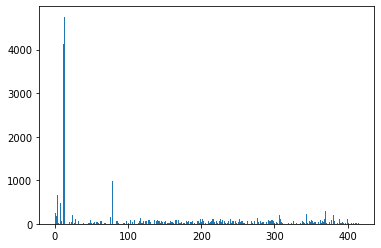

Feature 404: 0.358304


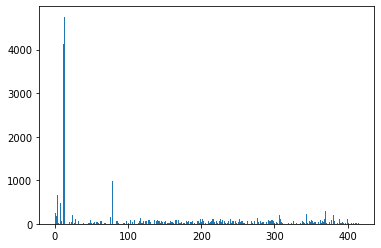

Feature 405: 9.651838


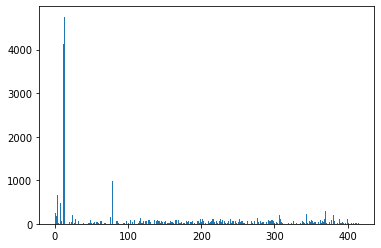

Feature 406: 72.430183


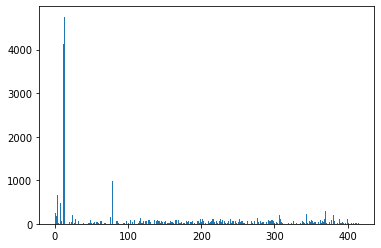

Feature 407: 1.402954


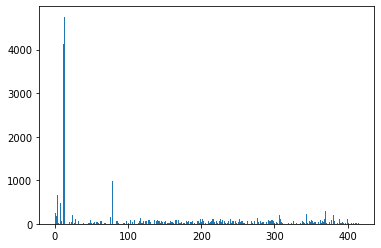

Feature 408: 14.686652


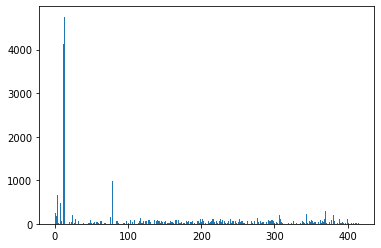

Feature 409: 0.511767


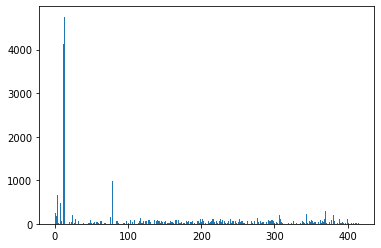

Feature 410: 4.215811


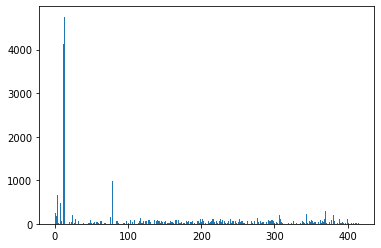

Feature 411: 21.464241


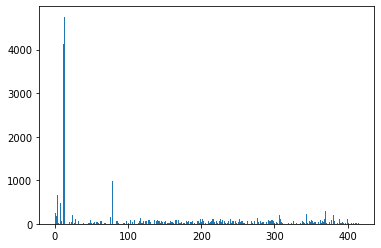

Feature 412: 21.476798


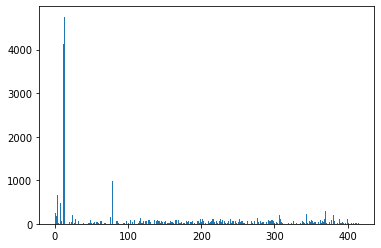

Feature 413: 55.045167


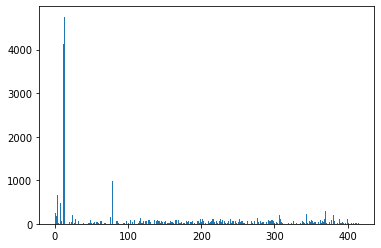

Feature 414: 28.520317


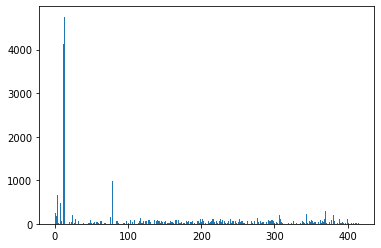

Feature 415: 22.690974


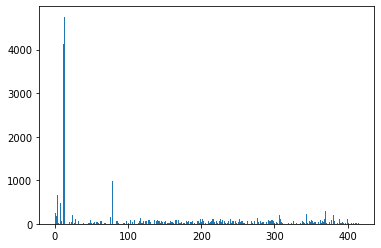

In [203]:
for i in range(len(fs.scores_)):
  print('Feature %d: %f' % (i, fs.scores_[i]))
  # plot the scores
  plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
  plt.show()

In [204]:
stats(y_test, yhat)

 the test MSE is:512465.05931211624
 the test RMSE is:715.866649112889
 the test MAE is:489.2836154702212
 the test Rsquared is:0.5231513908931398
 the test MAPE is:731639562129368.1


## Otimising Modals

## Lasso Regression
we will now use Grid Search Cv And Kfold method for finding best
value of cv, for improving modal accuracy

In [205]:
cv = RepeatedKFold(n_splits = 10, n_repeats = 3, random_state = 42 )
model = LassoCV(alphas = arange(0, 10, 0.1),fit_intercept=True, normalize=True, max_iter=5000, cv = cv)
model.fit(X_train_sc, y_train)

LassoCV(alphas=array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
       1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5,
       2.6, 2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8,
       3.9, 4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9, 5. , 5.1,
       5.2, 5.3, 5.4, 5.5, 5.6, 5.7, 5.8, 5.9, 6. , 6.1, 6.2, 6.3, 6.4,
       6.5, 6.6, 6.7, 6.8, 6.9, 7. , 7.1, 7.2, 7.3, 7.4, 7.5, 7.6, 7.7,
       7.8, 7.9, 8. , 8.1, 8.2, 8.3, 8.4, 8.5, 8.6, 8.7, 8.8, 8.9, 9. ,
       9.1, 9.2, 9.3, 9.4, 9.5, 9.6, 9.7, 9.8, 9.9]),
        cv=RepeatedKFold(n_repeats=3, n_splits=10, random_state=42),
        max_iter=5000, normalize=True)

In [206]:
yhat = model.predict(X_test_sc)
stats(y_test, yhat)

 the test MSE is:525106.259535999
 the test RMSE is:724.6421596457103
 the test MAE is:482.19942268118456
 the test Rsquared is:0.5113887572566317
 the test MAPE is:686592887796748.5


## Ridge Regression 
using GridSearchCV and KFOld

In [207]:
# Define technique to be used
reg_model = Ridge(fit_intercept=True, max_iter=3000)

# Define cross validation approach
cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=42)

# Define search grid for alpha hyperparameter
search_grid = dict()
# Set range and increments within range
search_grid['alpha'] = arange(.000001, .001, .005)

# Define and perform the search
search = GridSearchCV(reg_model, search_grid, scoring='r2', cv=cv, n_jobs=-1)
search_results = search.fit(X_train_sc, y_train)

# Show "optimal" hyperparameter setting and performance measure
print('Best Ridge Regression Hyperparameter Setting from Grid Search')
print('Ridge Config: %s'   % search_results.best_params_)
print('Best Value for Scoring Method: %.5f' % search_results.best_score_)

Best Ridge Regression Hyperparameter Setting from Grid Search
Ridge Config: {'alpha': 1e-06}
Best Value for Scoring Method: 0.52016


From above modals, we can now see Our Ridge and MultipleLinearRegression modal works better than Lasso regression even after optmisation and best feature selections

 # 6. Modeling for Policy Risk

In [208]:
df_TheGeneral.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   AbilitecContactID    11069 non-null  object 
 1   PolicyNumber         11069 non-null  object 
 2   DriverNumber         11069 non-null  int64  
 3   AbilitecHouseholdID  11069 non-null  object 
 4   DriverCount          11069 non-null  int64  
 5   ClaimCount           11069 non-null  int64  
 6   TotalPaid            11069 non-null  float64
 7   ClaimNumber          11069 non-null  object 
 8   AtFaultDescription   11069 non-null  object 
 9   ClaimStatus          11069 non-null  object 
 10  ClaimType            11069 non-null  object 
 11  DateOfLoss           11069 non-null  object 
 12  DriverID             11069 non-null  int64  
 13  LossState            11069 non-null  object 
 14  PolicyStateCode      10948 non-null  object 
 15  SubrogrationFlag     11069 non-null 

In [209]:
df_TheGeneral.head()

,AbilitecContactID,PolicyNumber,DriverNumber,AbilitecHouseholdID,DriverCount,ClaimCount,TotalPaid,ClaimNumber,AtFaultDescription,ClaimStatus,ClaimType,DateOfLoss,DriverID,LossState,PolicyStateCode,SubrogrationFlag,TermEffectiveDate,VehicleID,ClaimTransCount,ClaimTransPaidLoss,DaysToClaim,DaysToClaim_h
0,04ZJUS02EXPR09CB,Q080MDE1MTY2,1,04ZJUS0300X496LW,4,1,5086.61,PA0002364104,No fault,C,HAIL,2018-08-06 00:00:00,98,CO,CO,NO,2018-05-29 00:00:00,1,9.0,5086.61,0.0,0.0
1,04ZJUS0146KL4TTS,Q080MDEwOTEx,1,04ZJUS035SBF0GJ4,2,1,0.00,PA0002351705,Insured at fault,C,PG_IVREARENDCV,2018-05-24 00:00:00,1,CO,CO,NO,2018-05-24 00:00:00,1,4.0,0.00,0.0,0.0
2,04ZJUS02K2KC7DMW,Q080MDExOTIz,1,04ZJUS035ZXBZEH1,2,1,21397.74,PA0002344011,Insured at fault,C,PG_COLLISIONINTERSECTION,2018-06-17 00:00:00,1,CO,CO,NO,2018-05-25 00:00:00,1,53.0,21397.74,0.0,0.0
3,04ZJUS022XH2NVJ5,Q080MDIyMDcw,1,04ZJUS038P3W5KKR,5,3,0.00,PA0002348918,No fault,C,HAIL,2018-06-19 00:00:00,98,CO,CO,YES,2018-06-01 00:00:00,2,14.0,0.00,0.0,0.0
4,04ZJUS022XH2NVJ5,Q080MDIyMDcw,1,04ZJUS038P3W5KKR,5,3,0.00,PA0002348997,No fault,C,GLASSBREAKAGE,2018-06-30 00:00:00,1,CO,CO,NO,2018-06-01 00:00:00,2,1.0,0.00,0.0,0.0


In [210]:
# Cleaning & Imputing Data Set
df_TheGeneral.isnull().sum()

AbilitecContactID         0
PolicyNumber              0
DriverNumber              0
AbilitecHouseholdID       0
DriverCount               0
ClaimCount                0
TotalPaid                 0
ClaimNumber               0
AtFaultDescription        0
ClaimStatus               0
ClaimType                 0
DateOfLoss                0
DriverID                  0
LossState                 0
PolicyStateCode         121
SubrogrationFlag          0
TermEffectiveDate         0
VehicleID                 0
ClaimTransCount        1289
ClaimTransPaidLoss     1289
DaysToClaim            1289
DaysToClaim_h          1289
dtype: int64

In [211]:
# Let's impute this column with most common observations
df_TheGeneral.PolicyStateCode.unique()

array(['CO', nan, 'CA', 'CT', 'AK', 'AL', 'AR', 'AZ', 'GA', 'DC', 'DE',
       'FL', 'KS', 'KY', 'IN', 'IA', 'ID', 'IL', 'OH', 'OK', 'OR', 'LA',
       'MN', 'MO', 'MD', 'ME', 'MS', 'MT', 'NM', 'NC', 'ND', 'NE', 'NH',
       'NV', 'NY', 'SC', 'SD', 'PA', 'TN', 'RI', 'WA', 'WI', 'WV', 'WY',
       'TX', 'UT', 'VA', 'VT'], dtype=object)

In [212]:
df_TheGeneral['PolicyStateCode'] = df_TheGeneral.PolicyStateCode.fillna(df_TheGeneral['PolicyStateCode'].value_counts().index[0])

In [213]:
numeric_cols = ['ClaimTransCount', 'ClaimTransPaidLoss', 'DaysToClaim', 'DaysToClaim_h']
for col in numeric_cols:
  df_TheGeneral[col].fillna(df_TheGeneral[col].mean(), inplace=True)

In [214]:
df_TheGeneral.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   AbilitecContactID    11069 non-null  object 
 1   PolicyNumber         11069 non-null  object 
 2   DriverNumber         11069 non-null  int64  
 3   AbilitecHouseholdID  11069 non-null  object 
 4   DriverCount          11069 non-null  int64  
 5   ClaimCount           11069 non-null  int64  
 6   TotalPaid            11069 non-null  float64
 7   ClaimNumber          11069 non-null  object 
 8   AtFaultDescription   11069 non-null  object 
 9   ClaimStatus          11069 non-null  object 
 10  ClaimType            11069 non-null  object 
 11  DateOfLoss           11069 non-null  object 
 12  DriverID             11069 non-null  int64  
 13  LossState            11069 non-null  object 
 14  PolicyStateCode      11069 non-null  object 
 15  SubrogrationFlag     11069 non-null 

In [215]:
df_TheGeneral.isnull().sum()

AbilitecContactID      0
PolicyNumber           0
DriverNumber           0
AbilitecHouseholdID    0
DriverCount            0
ClaimCount             0
TotalPaid              0
ClaimNumber            0
AtFaultDescription     0
ClaimStatus            0
ClaimType              0
DateOfLoss             0
DriverID               0
LossState              0
PolicyStateCode        0
SubrogrationFlag       0
TermEffectiveDate      0
VehicleID              0
ClaimTransCount        0
ClaimTransPaidLoss     0
DaysToClaim            0
DaysToClaim_h          0
dtype: int64

## Preprocessing Data now

In [216]:
labels_to_encode = ['PolicyNumber', 'AbilitecHouseholdID', 'ClaimNumber', 'DateOfLoss', 'TermEffectiveDate']
dummy_vars = ['AtFaultDescription', 'ClaimStatus', 'ClaimType', 'LossState', 'PolicyStateCode', 'SubrogrationFlag' ]

In [217]:
# Let's now create dummy variables
dummies = pd.get_dummies(df_TheGeneral[dummy_vars])

In [218]:
dummies.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 168 columns):
 #    Column                                     Dtype
---   ------                                     -----
 0    AtFaultDescription_Comparative Negligence  uint8
 1    AtFaultDescription_Fault unknown           uint8
 2    AtFaultDescription_Insured at fault        uint8
 3    AtFaultDescription_No fault                uint8
 4    AtFaultDescription_Other party at fault    uint8
 5    ClaimStatus_C                              uint8
 6    ClaimStatus_O                              uint8
 7    ClaimType_2 CAR COLL MIN                   uint8
 8    ClaimType_ACCIDENT W/INJURY                uint8
 9    ClaimType_ANIMAL                           uint8
 10   ClaimType_BIKECOLLISION                    uint8
 11   ClaimType_COV ISSUE 2 OR LESS VEHS         uint8
 12   ClaimType_COV ISSUE 3 OR MORE VEHS         uint8
 13   ClaimType_COVERAGE ISSUE                   uint8
 14   Clai

In [219]:
# Let's remove columns that are converted to dummy variables
df_TheGeneral.drop(dummy_vars, inplace=True, axis=1)

In [220]:
# Now let's label encode our data
for col in labels_to_encode:
  df_TheGeneral[col] = lb.fit_transform(df_TheGeneral[col])

In [221]:
# Finally concatenating data set with dummy variables
df_TheGeneral = pd.concat([df_TheGeneral, dummies], axis=1)

In [222]:
df_TheGeneral.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 184 columns):
 #    Column                                     Dtype  
---   ------                                     -----  
 0    AbilitecContactID                          object 
 1    PolicyNumber                               int64  
 2    DriverNumber                               int64  
 3    AbilitecHouseholdID                        int64  
 4    DriverCount                                int64  
 5    ClaimCount                                 int64  
 6    TotalPaid                                  float64
 7    ClaimNumber                                int64  
 8    DateOfLoss                                 int64  
 9    DriverID                                   int64  
 10   TermEffectiveDate                          int64  
 11   VehicleID                                  int64  
 12   ClaimTransCount                            float64
 13   ClaimTransPaidLoss           

## Splitting Data
now our data is cleaned and preprocessed, we can now make split it

In [223]:
"""
We are now adding another column Risk to data set, and it's values will be either 1
or 0, based on If claimCount & ClaimTransPaidLoss
"""
df_TheGeneral['Risk'] = df_TheGeneral['ClaimCount'].apply(lambda x: 1 if x > 5 else 0)
df_TheGeneral['Risk'] = df_TheGeneral['ClaimTransPaidLoss'].apply(lambda x: 1 if x > df_TheGeneral['ClaimTransPaidLoss'].mean() else 0)

In [224]:
df_TheGeneral.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11069 entries, 0 to 11068
Data columns (total 185 columns):
 #    Column                                     Dtype  
---   ------                                     -----  
 0    AbilitecContactID                          object 
 1    PolicyNumber                               int64  
 2    DriverNumber                               int64  
 3    AbilitecHouseholdID                        int64  
 4    DriverCount                                int64  
 5    ClaimCount                                 int64  
 6    TotalPaid                                  float64
 7    ClaimNumber                                int64  
 8    DateOfLoss                                 int64  
 9    DriverID                                   int64  
 10   TermEffectiveDate                          int64  
 11   VehicleID                                  int64  
 12   ClaimTransCount                            float64
 13   ClaimTransPaidLoss           

In [225]:
X = df_TheGeneral.drop(['Risk', 'AbilitecContactID'], axis=1)
y = df_TheGeneral.Risk

In [226]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=33)

In [228]:
# Let's now scale data set
sc = StandardScaler()
sc.fit(X)

StandardScaler()

In [229]:
X_train_sc = sc.transform(X_train)
X_test_sc = sc.transform(X_test)

In [230]:
# Create Decision Tree classifer object
clf = DecisionTreeClassifier()

# Train Decision Tree Classifer
clf = clf.fit(X_train_sc,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test_sc)

## Displaying Stats for our classifier

In this section we will print, modal accuracy, confusion matrix, 
specificity and senstivity, also we will plot ROC curve

In [231]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",accuracy_score(y_test, y_pred))

Accuracy: 0.9996988858777477


In [232]:
print(classification_report(y_test, y_pred, target_names=['High Risk', 'Low Risk']))

              precision    recall  f1-score   support

   High Risk       1.00      1.00      1.00      2549
    Low Risk       1.00      1.00      1.00       772

    accuracy                           1.00      3321
   macro avg       1.00      1.00      1.00      3321
weighted avg       1.00      1.00      1.00      3321



In [237]:
# Let's Print Confusion Matrix
cm1 = confusion_matrix(y_test, y_pred)

In [240]:
# Let's Display specificity and senstivity
sensitivity = cm1[0,0]/(cm1[0,0]+cm1[0,1])
print('Sensitivity : ', sensitivity )

specificity = cm1[1,1]/(cm1[1,0]+cm1[1,1])
print('Specificity : ', specificity)

Sensitivity :  1.0
Specificity :  0.9987046632124352


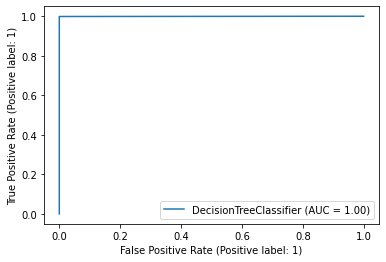

In [241]:
# Now let's plot ROC curve
plot_roc_curve(clf, X_test_sc, y_test) 